In [1]:
import sys
import seaborn as sb
import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import statsmodels.api as sm
import statsmodels.formula.api as smf
import argparse
import gc
import math
##import diffxpy.api as de
##import scvelo as scv
%matplotlib inline



In [2]:
%matplotlib inline

##################
# Configure file #
##################
sc.settings.verbosity = 2
sc.settings.autoshow = False

##logging.basicConfig(filename="CLUESImmVar_processed.V4.1.log", level=logging.ERROR)
sc.settings.set_figure_params(dpi=100, dpi_save=600, format='png')

plt.rcParams["image.aspect"] = "equal"
##%matplotlib inline

In [3]:
version = "V6.1"

figdir = "./figures."+version+"/"
sc.settings.figdir = figdir

In [7]:
savepath = '/Users/yechun/Downloads/CLUESImmvarLymph.'+version+".annotated.h5ad"

In [8]:
adata = sc.read("/Users/yechun/Downloads/CLUESImmvarLymph."+version+".annotated.h5ad", cache=False)
adata.shape

Only considering the two last: ['.annotated', '.h5ad'].
Only considering the two last: ['.annotated', '.h5ad'].


(524784, 1521)

In [9]:
pd.set_option('display.max_columns', None)
unique_leiden = np.unique(adata.obs['leiden'].values)
# Compile list of top genes
GeneRanks = pd.DataFrame()
for ii in range(len(unique_leiden)):
    GeneRanks[str('leiden_' + str(ii))] = adata.var_names[np.flipud(np.argsort(np.mean(adata.X[adata.obs['leiden'] == str(ii)], axis=0)))]
##GeneRanks.to_csv('FLARE_top_expression.csv')
GeneRanks.head(20)

,leiden_0,leiden_1,leiden_2,leiden_3,leiden_4,leiden_5,leiden_6,leiden_7,leiden_8,leiden_9,leiden_10,leiden_11,leiden_12,leiden_13,leiden_14,leiden_15,leiden_16,leiden_17,leiden_18,leiden_19,leiden_20,leiden_21
0,TSHZ2,CD79A,S100A4,GZMH,RP11-291B21.2,GZMB,RP5-887A10.1,GZMK,PPBP,SBF2,RTKN2,SLC4A10,XCL1,IFIT3,SOX4,HBA1,KIAA0101,EIF1AY,ACVR2B,HLA-DRA,TNFRSF17,ACVR2B
1,LTB,HLA-DRA,TNFRSF4,CCL5,CD8B,KLRF1,MS4A1,DUSP2,CLU,CTD-2035E11.3,RP11-1399P15.1,KLRB1,XCL2,IFI44L,CHI3L2,HBA2,TYMS,RPS4Y1,PRDM6,CD79A,MZB1,PRDM6
2,AIF1,TCL1A,ITGB1,NKG7,S100B,PRF1,HLA-DRA,CCL5,MYL9,IL32,IL2RA,GZMK,KLRC1,IFI6,ITM2A,FGFBP2,MKI67,DDX3Y,GABRE,CD74,IGJ,MS4A1
3,FAM13A,CD74,LTB,CST7,CD8A,SPON2,CD79A,LYAR,NRGN,CD8B,ICA1,KLRG1,CMC1,ISG15,AIF1,GZMB,STMN1,PRDM6,HBB,HLA-DQB1,DERL3,HLA-DQB1
4,EPHB6,CD79B,ANXA1,FGFBP2,AIF1,GNLY,BANK1,PIK3R1,TREML1,ZFP36L2,TIGIT,NCR3,GNLY,IFIT1,MIR181A1HG,NKG7,TK1,DONSON,DONSON,TCL1A,HRASLS2,HLA-DRA
5,TMIGD2,HLA-DQB1,IL32,GZMA,PASK,TYROBP,AL928768.3,CD8B,GP9,JUN,ARID5B,DUSP2,SPTSSB,MX1,LTB,PRF1,NUSAP1,TTTY15,IFI27,HLA-DPA1,ITM2C,BANK1
6,AC013264.2,HLA-DRB1,RP11-403A21.2,S100A4,CRTAM,FCER1G,CLECL1,CMC1,LTB,CD8A,IKZF2,LYAR,KLRF1,USP18,EPHB6,CST7,PCNA,UTY,PPBP,HLA-DPB1,AL928768.3,CD79A
7,HSPB1,MEF2C,S100A11,IL32,SPINK2,CLIC3,CD74,IL32,AIF1,TNFAIP3,DUSP4,AC092580.4,TYROBP,RSAD2,TMIGD2,SPON2,CLSPN,GABRE,PF4,HLA-DRB1,IGLL5,CD79B
8,SCGB3A1,MS4A1,TIMP1,CCL4,PRDM6,FGFBP2,HLA-DPA1,CD8A,PF4,HCST,FOXP3,CCL5,IL2RB,EIF2AK2,STMN1,GNLY,BIRC5,ACVR2B,CCL5,NKG7,CD38,HLA-DPA1
9,ITM2A,HLA-DPA1,GATA3,GNLY,DONSON,FCGR3A,HLA-DQA1,ZFP36L2,CD7,RP5-1073O3.7,IL32,GZMA,NCAM1,HERC5,HSPB1,GZMA,CENPF,LTB,NKG7,MS4A1,POU2AF1,CD74


In [10]:
adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('str')

## do some manual cell type assignment
adata.obs.loc[adata.obs.leiden == "0","ct_cov"] = "T4naive" # 
adata.obs.loc[adata.obs.leiden == "1","ct_cov"] = "Bnaive" # TCL1A downregulated in memory B
adata.obs.loc[adata.obs.leiden == "2","ct_cov"] = "T4cm" # CXCR3 positive
adata.obs.loc[adata.obs.leiden == "3","ct_cov"] = "T8em cyto1" # CXCR3+, CCR7-, GZMH+
adata.obs.loc[adata.obs.leiden == "4","ct_cov"] = "T8naive" # 
adata.obs.loc[adata.obs.leiden == "5","ct_cov"] = "NK CD56dim"# CD56dim, FCGR3A+, no CD3
adata.obs.loc[adata.obs.leiden == "6","ct_cov"] = "Bmem" # CXCR3
adata.obs.loc[adata.obs.leiden == "7","ct_cov"] = "T8em cyto2"# CXCR3+, CCR7+, GZMK+
adata.obs.loc[adata.obs.leiden == "8","ct_cov"] = "MKcontam" # 
adata.obs.loc[adata.obs.leiden == "9","ct_cov"] = "T8cm" # 
adata.obs.loc[adata.obs.leiden == "10","ct_cov"] = "T4reg" # CD27 late stage, CXCR3-, CCR7+, CD62L
adata.obs.loc[adata.obs.leiden == "11","ct_cov"] = "T8em MAIT" # CXCR3-, CCR7-, KLRB1+, should express TRAV1-2 TRVJ33
adata.obs.loc[adata.obs.leiden == "12","ct_cov"] = "NK CD56bright" # CD56bright, FCGR3A-, no CD3
adata.obs.loc[adata.obs.leiden == "13","ct_cov"] = "T4IFN" # 
adata.obs.loc[adata.obs.leiden == "14","ct_cov"] = "Progenitor" # 
adata.obs.loc[adata.obs.leiden == "15","ct_cov"] = "NKT" # CD56DIM, FCGR3A-, CD3 ?
adata.obs.loc[adata.obs.leiden == "16","ct_cov"] = "TProlif" #
adata.obs.loc[adata.obs.leiden == "17","ct_cov"] = "T4naive" #
adata.obs.loc[adata.obs.leiden == "18","ct_cov"] = "T8cm" # CD27 late stage, CXCR3-, CCR7+, CD62L
adata.obs.loc[adata.obs.leiden == "19","ct_cov"] = "Batypical" #
adata.obs.loc[adata.obs.leiden == "20","ct_cov"] = "Bplasma" #
adata.obs.loc[adata.obs.leiden == "21","ct_cov"] = "Bmem" #

adata.obs['ct_cov'] = adata.obs['ct_cov'].astype('category')

In [11]:
adata.obs['ct_cov'].cat.categories

Index(['Batypical', 'Bmem', 'Bnaive', 'Bplasma', 'MKcontam', 'NK CD56bright',
       'NK CD56dim', 'NKT', 'Progenitor', 'T4IFN', 'T4cm', 'T4naive', 'T4reg',
       'T8cm', 'T8em MAIT', 'T8em cyto1', 'T8em cyto2', 'T8naive', 'TProlif'],
      dtype='object')

In [12]:
adata.obs.to_csv('adata.lymph.obs.txt')

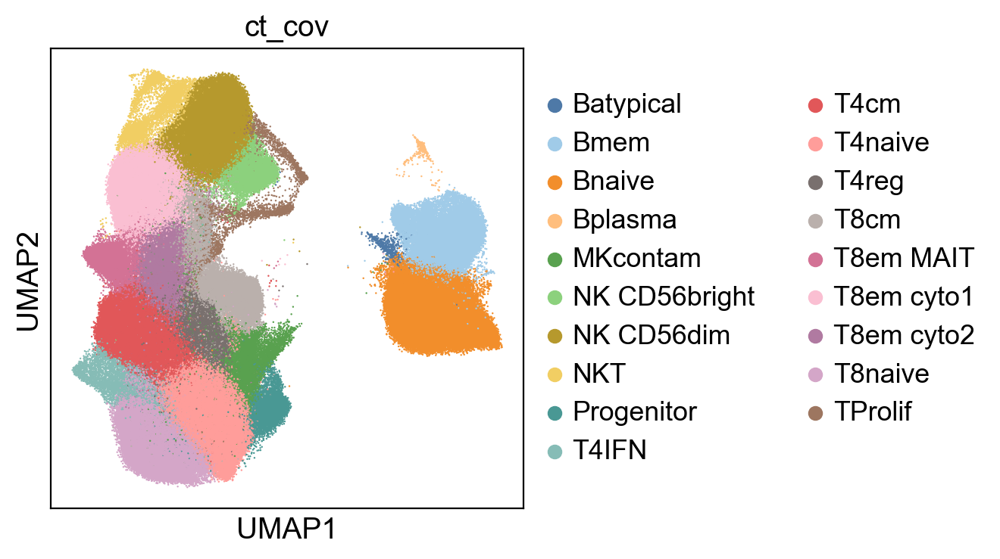

In [13]:
#plot UMAP of cell types colored by clusters
sc.pl.palettes.vega_20_scanpy;
adata.uns['ct_cov_colors'] = sc.pl.palettes.vega_20_scanpy;
adata.uns['ct_cov_colors'] = ["#4E79A7","#A0CBE8","#F28E2B","#FFBE7D","#59A14F","#8CD17D","#B6992D","#F1CE63","#499894","#86BCB6","#E15759","#FF9D9A","#79706E","#BAB0AC","#D37295","#FABFD2","#B07AA1","#D4A6C8","#9D7660","#D7B5A6"]
sc.pl.umap(adata, color='ct_cov', size = 3)
sc.pl.umap(adata, color='ct_cov', size=2, edgecolor="none", save=".ct_cov.png")

In [11]:
sc.tl.embedding_density(adata, basis='umap', groupby='disease_pop_site_cov')


computing density on 'umap'


saving figure to file ./figures.V6/umap_density_disease_pop_site_cov_.density.png


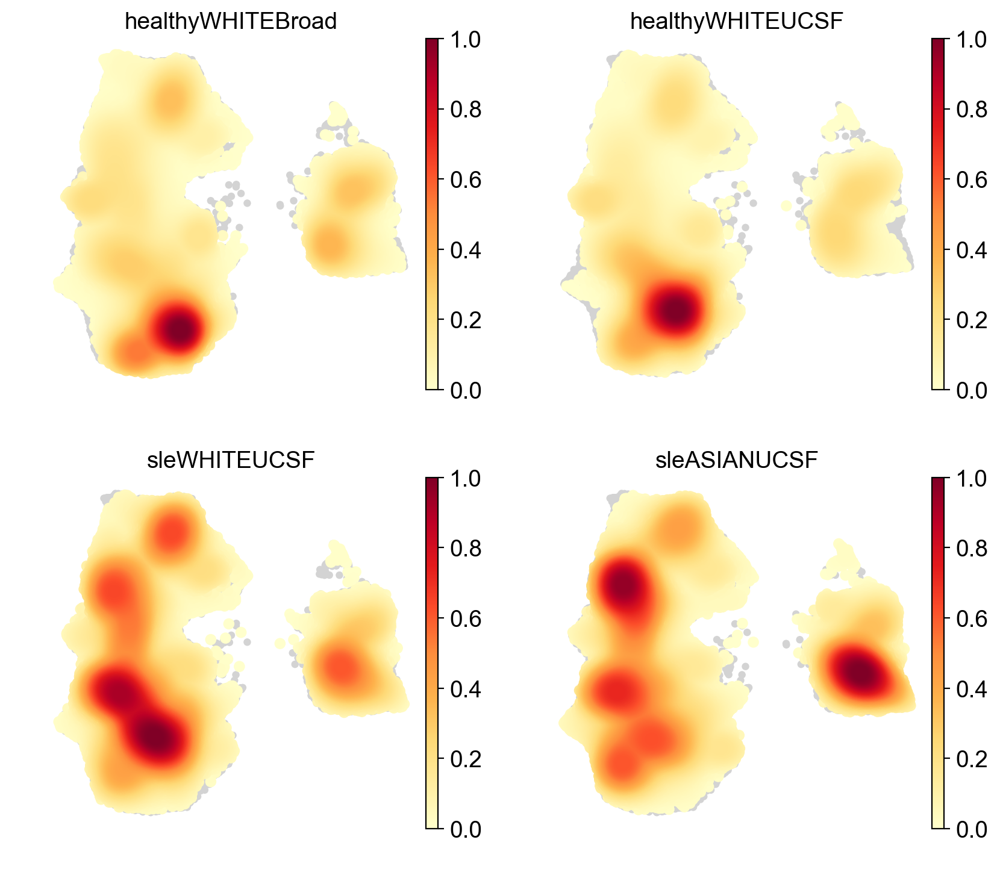

In [12]:
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2)
disease_umap = sc.pl.embedding_density(adata, basis="umap", key="umap_density_disease_pop_site_cov", frameon=False, ncols=2, save=".density.png")

In [13]:
def marker_gene_expression(anndata, marker_dict, gene_symbol_key=None, partition_key='louvain_r1'):
    """A function go get mean z-score expressions of marker genes
    # 
    # Inputs:
    #    anndata         - An AnnData object containing the data set and a partition
    #    marker_dict     - A dictionary with cell-type markers. The markers should be stores as anndata.var_names or 
    #                      an anndata.var field with the key given by the gene_symbol_key input
    #    gene_symbol_key - The key for the anndata.var field with gene IDs or names that correspond to the marker 
    #                      genes
    #    partition_key   - The key for the anndata.obs field where the cluster IDs are stored. The default is
    #                      'louvain_r1' """

    #Test inputs
    if partition_key not in anndata.obs.columns.values:
        print('KeyError: The partition key was not found in the passed AnnData object.')
        print('   Have you done the clustering? If so, please tell pass the cluster IDs with the AnnData object!')
        raise

    if (gene_symbol_key != None) and (gene_symbol_key not in anndata.var.columns.values):
        print('KeyError: The provided gene symbol key was not found in the passed AnnData object.')
        print('   Check that your cell type markers are given in a format that your anndata object knows!')
        raise
        

    if gene_symbol_key:
        gene_ids = anndata.var[gene_symbol_key]
    else:
        gene_ids = anndata.var_names

    clusters = anndata.obs[partition_key].cat.categories
    n_clust = len(clusters)
    marker_exp = pd.DataFrame(columns=clusters)
    marker_exp['cell_type'] = pd.Series({}, dtype='str')
    marker_names = []
    
    z_scores = sc.pp.scale(anndata, copy=True)

    i = 0
    for group in marker_dict:
        # Find the corresponding columns and get their mean expression in the cluster
        for gene in marker_dict[group]:
            ens_idx = np.in1d(gene_ids, gene) #Note there may be multiple mappings
            if np.sum(ens_idx) == 0:
                continue
            else:
                z_scores.obs[ens_idx[0]] = z_scores.X[:,ens_idx].mean(1) #works for both single and multiple mapping
                ens_idx = ens_idx[0]

            clust_marker_exp = z_scores.obs.groupby(partition_key)[ens_idx].apply(np.mean).tolist()
            clust_marker_exp.append(group)
            marker_exp.loc[i] = clust_marker_exp
            marker_names.append(gene)
            i+=1

    #Replace the rownames with informative gene symbols
    marker_exp.index = marker_names

    return(marker_exp)

In [14]:
marker_dictionary = pd.DataFrame({"all": adata.var_names})

rst = marker_gene_expression(adata, marker_dictionary, partition_key="ct_cov")

In [15]:
rst.to_csv("lymph_expr.ct_cov.csv")

ranking genes


/Users/yimmieg/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in greater
  return (self.a < x) & (x < self.b)
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:877: RuntimeWarning: invalid value encountered in less
  return (self.a < x) & (x < self.b)
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:1831: RuntimeWarning: invalid value encountered in less_equal
  cond2 = cond0 & (x <= self.a)


    finished (0:04:20.54)


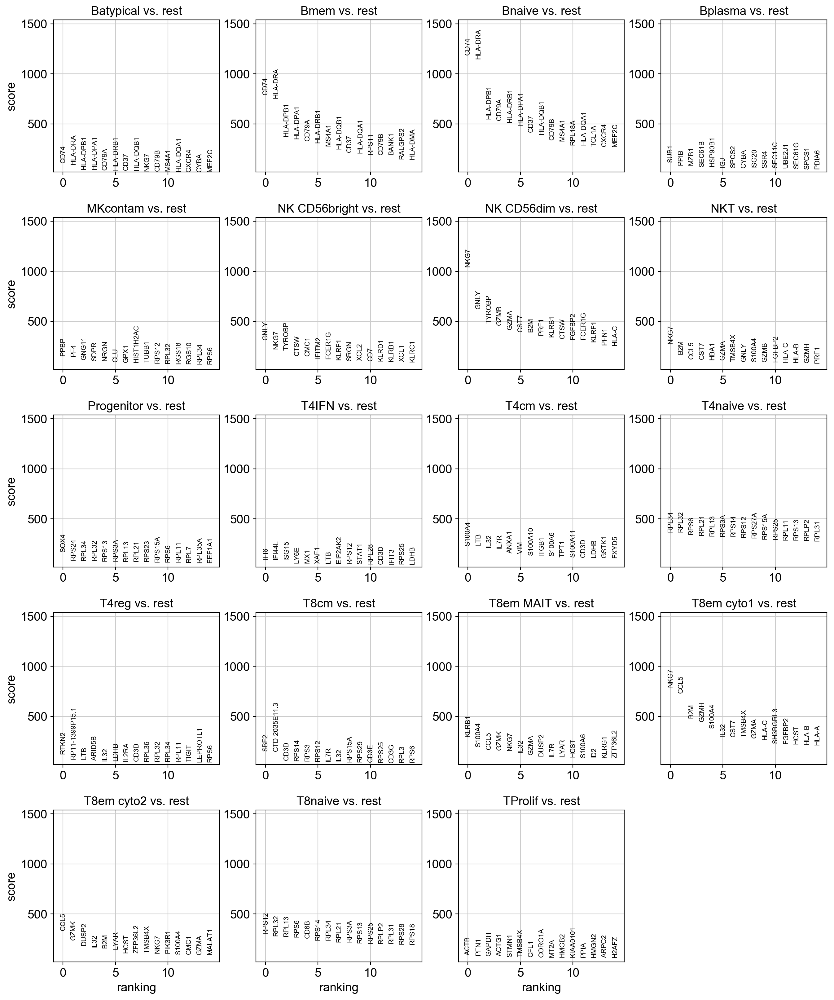

In [16]:
sc.tl.rank_genes_groups(adata,groupby='ct_cov',method='t-test',n_genes=15)
sc.pl.rank_genes_groups(adata)

# pd.set_option('display.max_columns', None)
unique_leiden = np.unique(adata.obs['ct_cov'].values)
# Compile list of top genes
GeneRanks = pd.DataFrame()
for ii in range(len(unique_leiden)):
    GeneRanks[unique_leiden[ii]] = adata.var_names[np.flipud(np.argsort(np.mean(adata.X[adata.obs['ct_cov'] == str(unique_leiden[ii])], axis=0)))]
##GeneRanks.to_csv('FLARE_top_expression.csv')
GeneRanks.head(20)

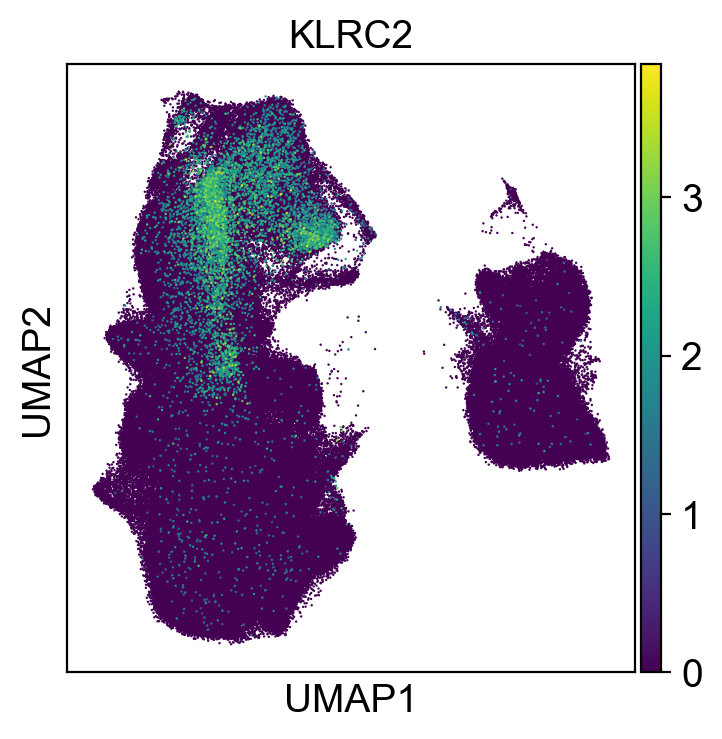

In [14]:
sc.pl.umap(adata, color=['KLRC2'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

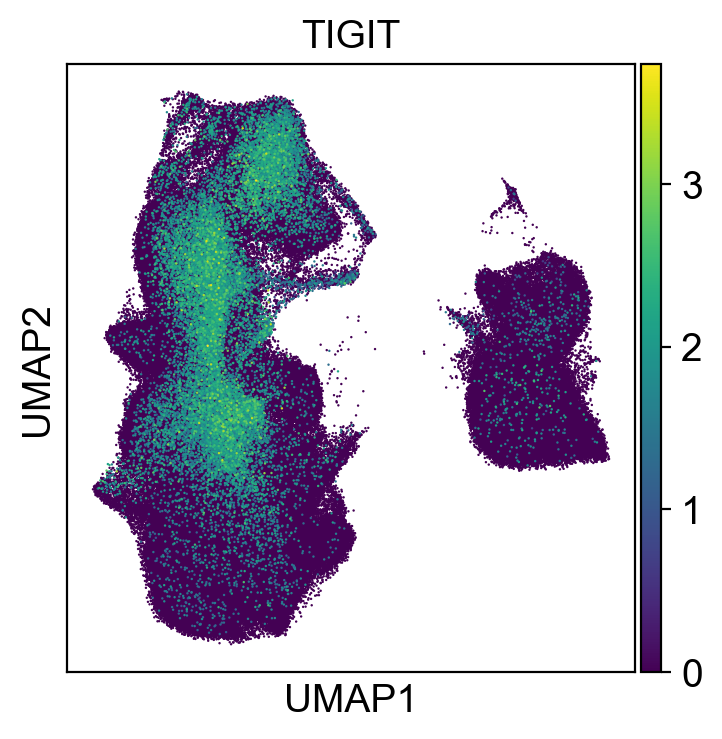

In [15]:
sc.pl.umap(adata, color=['TIGIT'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

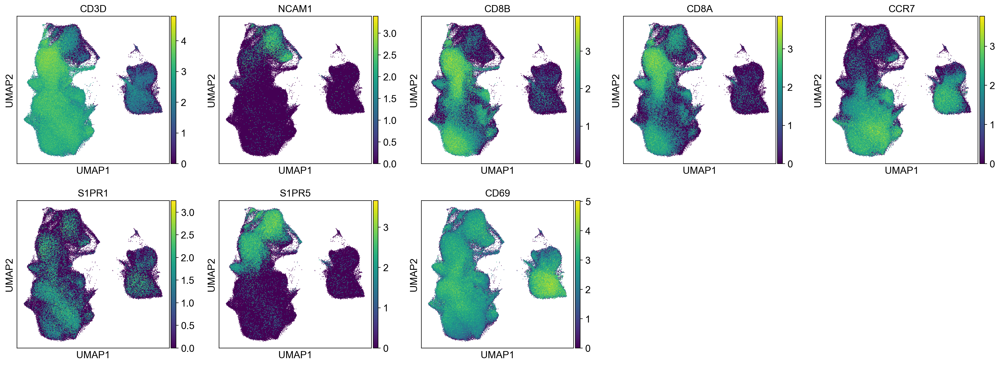

In [17]:
sc.pl.umap(adata, color=['CD3D', 'NCAM1','CD8B','CD8A','CCR7','S1PR1','S1PR5', 'CD69'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

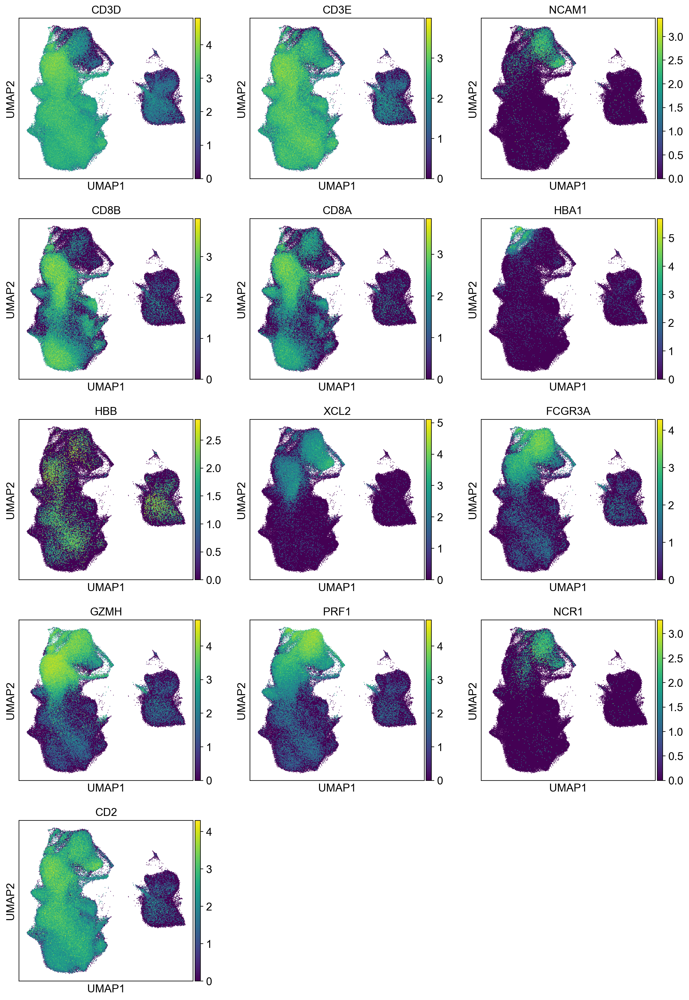

In [18]:
sc.pl.umap(adata, color=['CD3D', 'CD3E', 'NCAM1','CD8B','CD8A', 'HBA1', 'HBB', 'XCL2', 'FCGR3A', 'GZMH', 'PRF1','NCR1','CD2'], palette="Greys", size=3, ncols=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

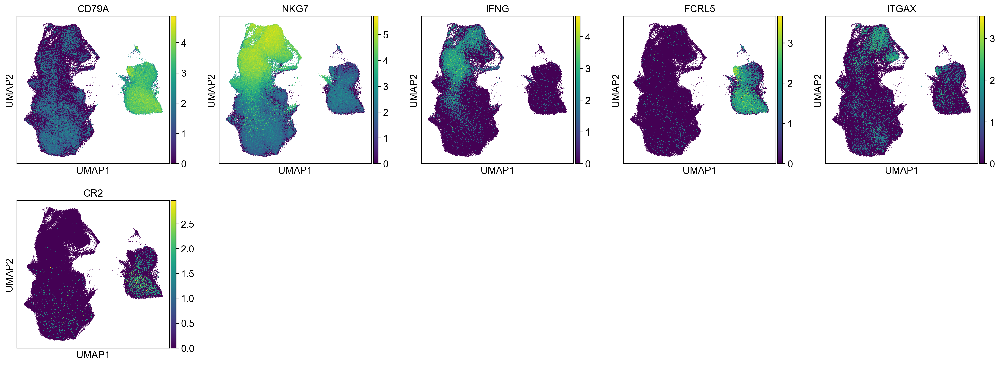

In [19]:
sc.pl.umap(adata, color=['CD79A', 'NKG7', 'IFNG', 'FCRL5','ITGAX','CR2'], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

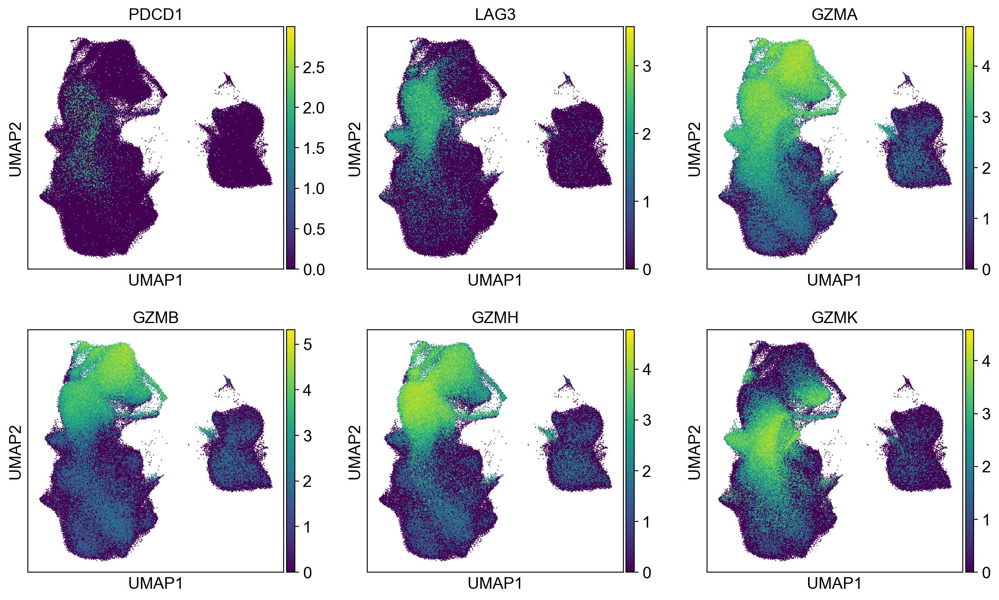

In [20]:
sc.pl.umap(adata, color=['PDCD1', 'LAG3', 'GZMA', 'GZMB', 'GZMH', 'GZMK'], palette="Greys", size=3, ncols=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

8721/158245

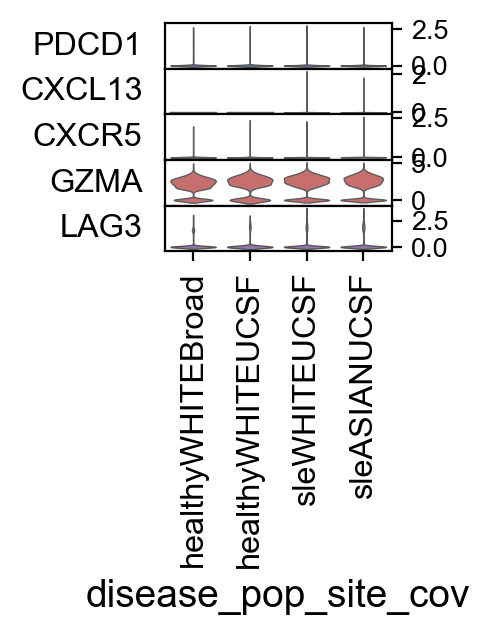

In [21]:
sc.pl.stacked_violin(adata[adata.obs.ct_cov=="T8em cyto1"], var_names=['PDCD1','CXCL13','CXCR5','GZMA', 'LAG3'], groupby="disease_pop_site_cov", swap_axes=True, standard_scale=None)


saving figure to file ./figures.V6/stacked_violin.violin.png


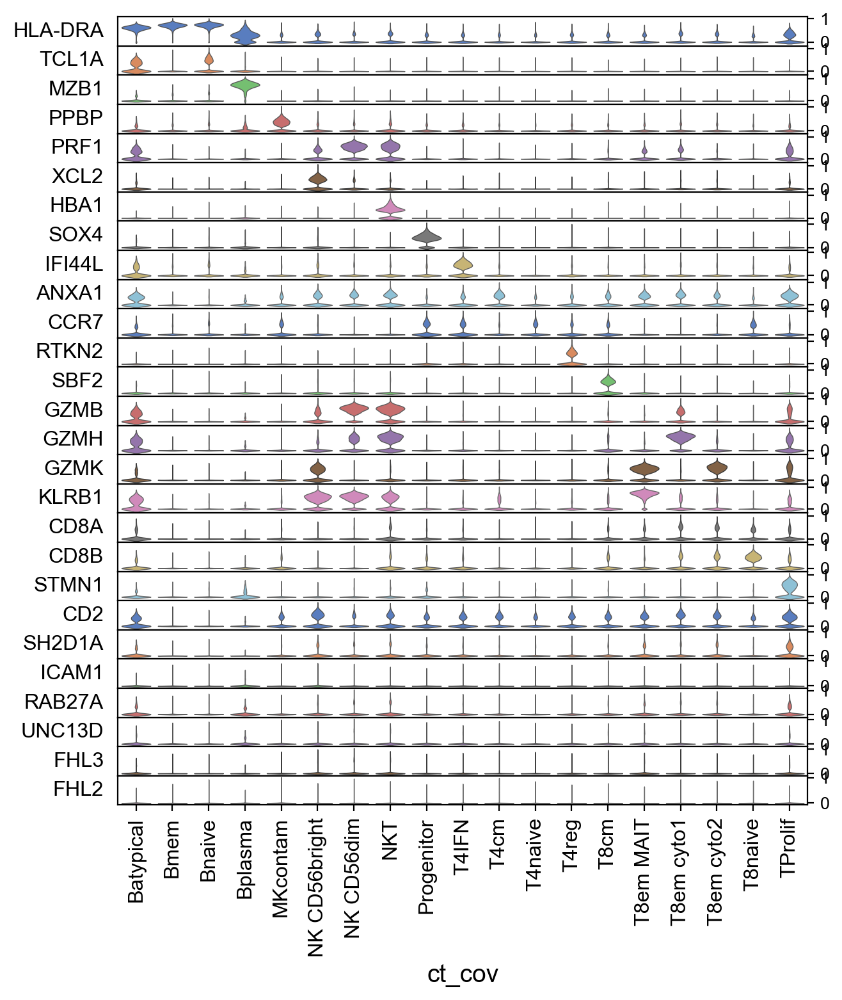

In [22]:
##['CD4','CD8B','NKG7','GZMK','GZMB','CCR7','LTB','CCL5', 'IFI6', 'CD79A','MZB1','FOXP3','XCL1','SOX4','PF4']
## 'TNFRSF4','TSHZ2','ANXA1', 'AIF1', 'S100A4','TIMP1','GATA3' don't look very good
sc.pl.stacked_violin(adata, var_names=['HLA-DRA','TCL1A','MZB1','PPBP', 'PRF1', 'XCL2', 'HBA1', 'SOX4', 'IFI44L', 'ANXA1', 'CCR7', 'RTKN2', 'SBF2', 'GZMB','GZMH','GZMK','KLRB1', 'CD8A', 'CD8B', 'STMN1', 'CD2', 'SH2D1A', 'ICAM1', 'RAB27A', 'UNC13D', 'FHL3', 'FHL2'], groupby="ct_cov", swap_axes=True, standard_scale="var")
sc.pl.stacked_violin(adata, var_names=['HLA-DRA','TCL1A','MZB1','PPBP', 'PRF1', 'XCL2', 'HBA1', 'SOX4', 'IFI44L', 'ANXA1', 'CCR7', 'RTKN2', 'SBF2', 'GZMB','GZMH','GZMK','KLRB1', 'CD8B', 'STMN1'], groupby="ct_cov", save=".violin.png", swap_axes=True, standard_scale="var")

In [23]:
# ct_counts=adata.obs.groupby(['ind_cov', 'pop_cov', 'disease_cov', 'batch_cov', 'disease_pop_cov','ct_cov'])['ct_cov'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ct_counts_sums = ct_counts.groupby(["ind_cov","batch_cov"]).sum()
# ct_counts_sums = ct_counts_sums.reset_index(name="counts")

# ct_percs = ct_counts/ct_counts.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')

# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.ct_cov = ct_percs.ct_cov.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ct_percs['site'] = pd.Categorical(ct_percs.disease_cov, categories=['Broad','UCSF'])
# ct_percs.site[ct_percs.batch_cov.str.contains("immvar")] = "Broad"
# ct_percs.site[~ct_percs.batch_cov.str.contains("immvar")] = "UCSF"

# ct_percs['disease_pop_site_cov'] = pd.Categorical(ct_percs.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)

# print(ct_percs.shape)
# print(ct_counts_sums.shape)

# ## for now, let's filter out one of the reps for the healthies from UCSF only
# ct_percs_broad = ct_percs[~ct_percs.batch_cov.str.contains("lupus")]
# ct_percs_ucsf = ct_percs[ct_percs.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
# ct_percs = ct_percs_ucsf.append(ct_percs_broad);

# ct_counts_sums_broad = ct_counts_sums[~ct_counts_sums.batch_cov.str.contains("lupus")]
# ct_counts_sums_ucsf = ct_counts_sums[ct_counts_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
# ct_counts_sums = ct_counts_sums_ucsf.append(ct_counts_sums_broad);

# print(ct_percs.shape)
# print(ct_counts_sums.shape)


# ##plt.figure(figsize=(20,8))
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', 
#                 dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
#                palette = ["#4E79A7","#A0CBE8","#F28E2B","#FFBE7D","#59A14F","#8CD17D","#B6992D","#F1CE63","#499894","#86BCB6","#E15759","#FF9D9A","#79706E","#BAB0AC","#D37295","#FABFD2","#B07AA1","#D4A6C8","#9D7660","#D7B5A6"]) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

# for ct_i in list(range(len(ct_percs.ct_cov.cat.categories))) :
#     ct = ct_percs.ct_cov.cat.categories[ct_i]
    
#     sb.pointplot(x="disease_pop_site_cov", y="ct_percs", hue = "ind_cov", data=ct_percs[ct_percs.ct_cov == ct], color="0", scale=0.5,
#                  ax=plot.axes[ct_i], legend=False)
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)
#     plot.axes[ct_i].get_legend().remove()
    
# #     sb.swarmplot(x="disease_pop_site_cov", y="ct_percs", data=ct_percs[ct_percs.ct_cov == ct], color="0", size=3, ax=plot.axes[ct_i])##ct_i%2,ct_i%10])
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)

# plot.savefig(figdir+"/violin.lymph.png")
# #plt.subplots_adjust(wspace=0.03)

# TCR Analysis

In [17]:
th_tcr = pd.read_csv("Th_sharedclones_hiseq_CDR3.csv", index_col=False)
tc_tcr = pd.read_csv("Tc_sharedclones_hiseq_CDR3.csv", index_col=False)
all_tcr = pd.read_csv("TCR_paired_final_hiseq.csv", index_col=False)

In [18]:
all_tcr[all_tcr.ct_cov=="Th"].shape

(11855, 16)

In [19]:
all_tcr[all_tcr.ct_cov=="Tc"].shape

(8721, 16)

In [20]:
sum(adata.obs.ct_cov.str.contains("T4"))

179861

In [21]:
sum(adata.obs.ct_cov.str.contains("T8"))

158245

In [22]:
11855/179861

0.06591200982981302

In [23]:
8721/158245

0.05511074599513413

In [24]:
# all_tcr[(all_tcr.alphaJGene=="TRAJ33") & (all_tcr.alphaVGene=="TRAV1-2")]

In [25]:
all_tcr_mait = all_tcr.loc[(all_tcr.alphaJGene=="TRAJ33") & (all_tcr.alphaVGene=="TRAV1-2")]

In [26]:
all_tcr_nkt = all_tcr.loc[(all_tcr.alphaVGene=="TRAV24")]

In [27]:
all_tcr_tc_expanded_matched = all_tcr.loc[(all_tcr.alphaCDR3+"."+all_tcr.betaCDR3).isin(tc_tcr.TCR[tc_tcr['total.cells'] > 2])]
all_tcr_th_expanded_matched = all_tcr.loc[(all_tcr.alphaCDR3+"."+all_tcr.betaCDR3).isin(th_tcr.TCR[th_tcr['total.cells'] > 2])]
all_tcr_matched = all_tcr.loc[(all_tcr.alphaCDR3+"."+all_tcr.betaCDR3).isin(tc_tcr.TCR[tc_tcr['total.cells'] > 0])]

In [28]:
all_tcr_tc_alpha_expanded_matched = all_tcr.loc[all_tcr.alphaCDR3.isin(tc_tcr.TCR[tc_tcr['total.cells'] > 2])]
all_tcr_th_alpha_expanded_matched = all_tcr.loc[all_tcr.alphaCDR3.isin(th_tcr.TCR[th_tcr['total.cells'] > 2])]

all_tcr_tc_beta_expanded_matched = all_tcr.loc[all_tcr.betaCDR3.isin(tc_tcr.TCR[tc_tcr['total.cells'] > 2])]
all_tcr_th_beta_expanded_matched = all_tcr.loc[all_tcr.betaCDR3.isin(th_tcr.TCR[th_tcr['total.cells'] > 2])]

all_tcr_matched = all_tcr.loc[(all_tcr.alphaCDR3+"."+all_tcr.betaCDR3).isin(tc_tcr.TCR[tc_tcr['total.cells'] > 0])]

In [29]:
adata.obs["tcr"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "tcr"] = 1

In [30]:
adata.obs["nkt"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_nkt["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_nkt["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "mait"] = 1

In [31]:
from pandas.api.types import CategoricalDtype
adata.obs["mait"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_mait["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_mait["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "mait"] = 1
adata.obs["mait"] = adata.obs["mait"].astype("category")

In [32]:
adata.obs["tc_expanded"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_tc_expanded_matched["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_tc_expanded_matched["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "tc_expanded"] = 1
adata.obs["tc_expanded"] = adata.obs["tc_expanded"].astype("category")

In [33]:
adata.obs["tc_alpha_expanded"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_tc_alpha_expanded_matched["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_tc_alpha_expanded_matched["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "tc_alpha_expanded"] = 1

adata.obs["tc_beta_expanded"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_tc_beta_expanded_matched["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_tc_beta_expanded_matched["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "tc_beta_expanded"] = 1

In [34]:
adata.obs["th_alpha_expanded"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_th_alpha_expanded_matched["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_th_alpha_expanded_matched["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "th_alpha_expanded"] = 1

adata.obs["th_beta_expanded"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_th_beta_expanded_matched["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_th_beta_expanded_matched["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "th_beta_expanded"] = 1

In [35]:
adata.obs["th_expanded"] = 0
cell_index_match = (adata.obs.index.str.slice(0, 16)).isin(all_tcr_th_expanded_matched["cell-barcode"]);
ind_cov_match = (adata.obs.ind_cov).isin(all_tcr_th_expanded_matched["ind_cov"])
adata.obs.loc[(cell_index_match & ind_cov_match), "th_expanded"] = 1
adata.obs["th_expanded"] = adata.obs["th_expanded"].astype("category")

saving figure to file ./figures.V6/umap.tcr_nkt.png


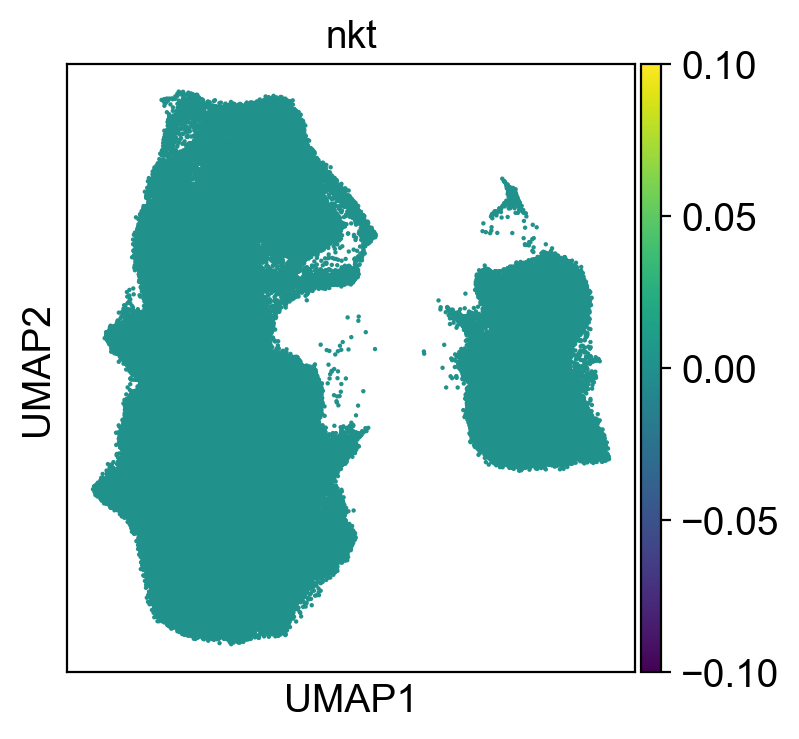

In [43]:
sc.pl.umap(adata, color='nkt', size = 10)
sc.pl.umap(adata, color='nkt', size=10, edgecolor="none", save=".tcr_nkt.png")

saving figure to file ./figures.V6/umap.tcr_mait.png


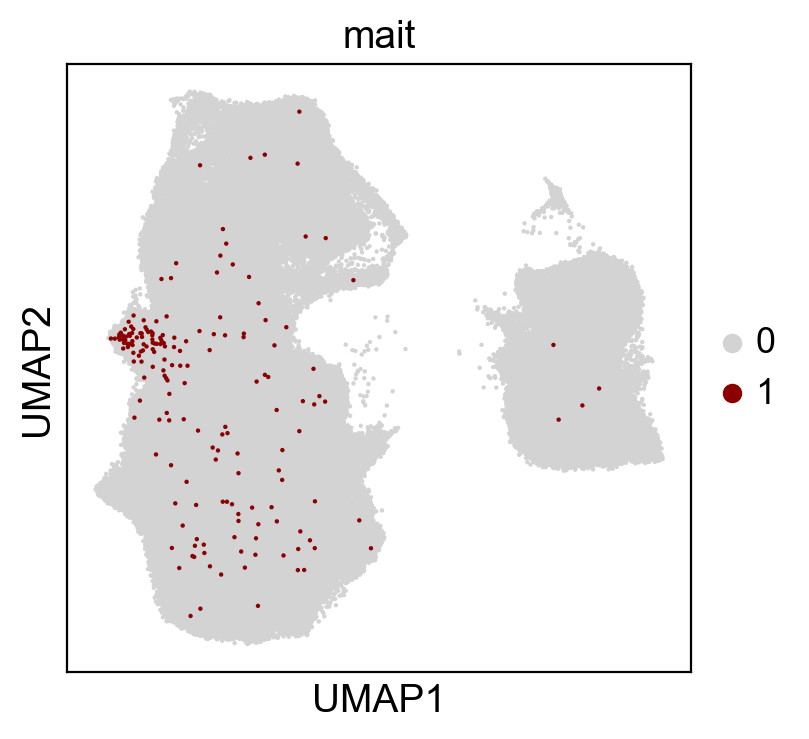

In [44]:
sc.pl.umap(adata[adata.obs.mait.argsort()], color='mait', size = 10, palette=["lightgray","darkred"])
sc.pl.umap(adata[adata.obs.mait.argsort()], color='mait', size=10, edgecolor="none", save=".tcr_mait.png", palette=["lightgray","darkred"])

saving figure to file ./figures.V6/umap.tcr_th_expansion.png


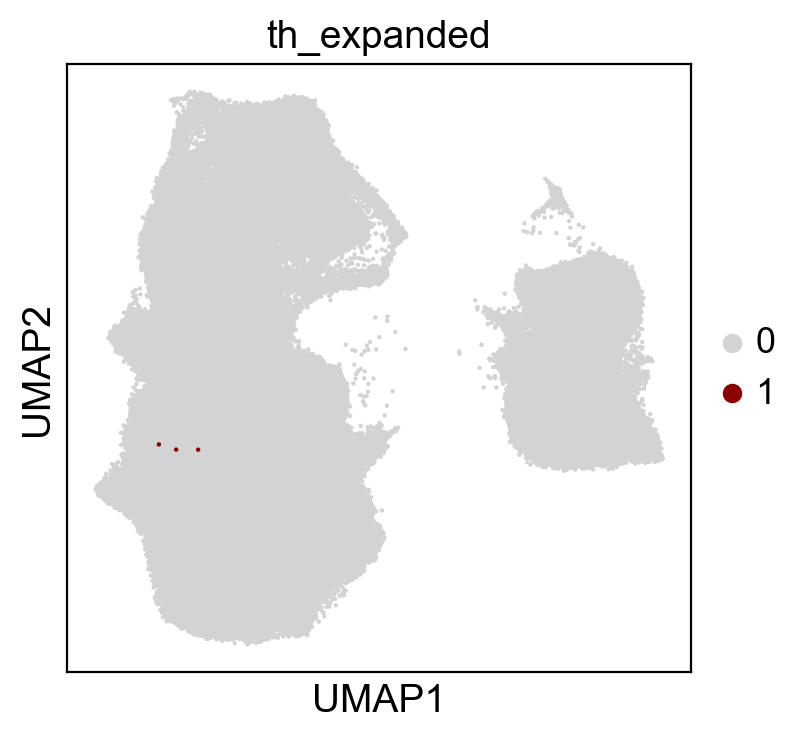

In [45]:
sc.pl.umap(adata[adata.obs.th_expanded.argsort()], color='th_expanded', size = 10, palette=["lightgray","darkred"])
sc.pl.umap(adata[adata.obs.th_expanded.argsort()], color='th_expanded', size=10, edgecolor="none", save=".tcr_th_expansion.png", palette=["lightgray","darkred"])

In [59]:
tc_tcr.shape

(8169, 4)

In [60]:
list(tc_tcr[tc_tcr["total.cells"]>2].TCR)

['CAADNAGGTSYGKLTF.CASSLAGTGEQYF',
 'CAAFIQGAQKLVF.CASSSGPLDSPLHF',
 'CAAIGRQAGTALIF.CASSVGDGISGANVLTF',
 'CAALYGQNFVF.CASSGTAENEQFF',
 'CAANAGNMLTF.CASSQTSGGNNEQFF',
 'CAARPGAQKLVF.CASSLEGGPRPYEQYF',
 'CAASDLGYNFNKFYF.CATTNLGEQYF',
 'CAASGAKAAGNKLTF.CASSPGYRDDYGYTF',
 'CAASGEDNFNKFYF.CASSLGAGFTEAFF',
 'CAASIWYSTLTF.CSVPTDSTEAFF',
 'CAASMEWSGNTGKLIF.CASSPGQNFFQETQYF',
 'CAASVPGGSYIPTF.CASSPLELNTEAFF',
 'CAATGGFKTIF.CASSRGQARETQYF',
 'CAEKDNARLMF.CAWSLDRRTEAFF',
 'CAENLGSGNTGKLIF.CASSFGGTGWTGELFF',
 'CAERRSSASKIIF.CASSFGGLAGGVDEQFF',
 'CAFMGYNNNDMRF.CASSRRGTGELFF',
 'CAGGSTDKLIF.CASSYPDGHYSNQPQHF',
 'CAGMIKAAGNKLTF.CASSLASSLYNEQFF',
 'CAGQKGTYKYIF.CASSPRTQDTDTQYF',
 'CAISGGSYIPTF.CASTKRTSSYNEQFF',
 'CALASGTYKYIF.CASSRPSGRAADTQYF',
 'CALIWGNNNDMRF.CASSLEAGRSPLHF',
 'CALRRDDKIIF.CASSLDPYNEQFF',
 'CALSAQIMDTGRRALTF.CASSLEQGARSNEQFF',
 'CALSDLNNAGNMLTF.CASSPPGTGVSPLHF',
 'CALSEGEGRRALTF.CASSSGTGNAYNEQFF',
 'CALSEGGSRLTF.CSVAEGGVYGYTF',
 'CALSENNDMRF.CASSRGQSYNEQFF',
 'CALSGRAIKAAGNKLTF.CASS

In [39]:
all_tcr_tc_expanded_matched

,Sample_ID,cell-barcode,alphaClonalSeq,alphaCDR3,alphaVGene,alphaJGene,alphaDGene,betaClonalSeq,betaCDR3,betaVGene,betaJGene,betaDGene,cloneCount,UMICount,ct_cov,ind_cov
99,lupus8.17,GGGAATGGTCTCGTTC,TGTGCTGTTAATCGCGGATATGGAAACAAACTGGTCTTT,CAVNRGYGNKLVF,TRAV13-2,TRAJ47,NaN,TGTGCCAGTAGCTATGGACTAGGGGACAATGAGCAGTTCTTC,CASSYGLGDNEQFF,TRBV19,TRBJ2-1,NaN,174,4,Tc,1641_1641
102,lupus8.17,GTCAAGTTCAGGCGAA,TGTGCTGTAAAAAGGAATAACAATGCCAGACTCATGTTT,CAVKRNNNARLMF,TRAV3,TRAJ31,NaN,TGTGCCAGCAGCCAAAAAGGGGGTAGCGGGGGAGATACGCAGTATTTT,CASSQKGGSGGDTQYF,TRBV7-2,TRBJ2-3,TRBD2,39,2,Tc,904025200_904025200
160,lupus8.17,CATCGAAAGGGCATGT,TGTGCATCCTCCCCCAGTGGGAACAACAGACTCGCTTTT,CASSPSGNNRLAF,TRAV13-1,TRAJ7,NaN,TGTGCCAGCAGCTTTTTAGGCGAGCAGTACTTC,CASSFLGEQYF,TRBV7-9,TRBJ2-7,NaN,352,8,Tc,1641_1641
323,lupus8.17,CACACCTGTATTCGTG,TGTGCTGTGGAGCGCCCAACTCAGGGCGGATCTGAAAAGCTGGTCTTT,CAVERPTQGGSEKLVF,TRAV22,TRAJ57,NaN,TGTGCCAGTAGTATAGACAGTCAATCACCCCTCCACTTT,CASSIDSQSPLHF,TRBV19,TRBJ1-6,NaN,93,4,Tc,904025200_904025200
367,lupus8.17,GACGTGCTCCAAATGC,TGTGCTGTTAATCGCGGATATGGAAACAAACTGGTCTTT,CAVNRGYGNKLVF,TRAV13-2,TRAJ47,NaN,TGTGCCAGTAGCTATGGACTAGGGGACAATGAGCAGTTCTTC,CASSYGLGDNEQFF,TRBV19,TRBJ2-1,NaN,21,4,Tc,1641_1641
369,lupus8.17,CTCGGGAGTACGACCC,TGTGCATCCTCCCCCAGTGGGAACAACAGACTCGCTTTT,CASSPSGNNRLAF,TRAV13-1,TRAJ7,NaN,TGTGCCAGCAGCTTTTTAGGCGAGCAGTACTTC,CASSFLGEQYF,TRBV7-9,TRBJ2-7,NaN,3268,12,Tc,1641_1641
430,lupus8.17,CTAGCCTGTCGGATCC,TGTGTGGTGAGATCTTCCGGGTATGCACTCAACTTC,CVVRSSGYALNF,TRAV12-1,TRAJ41,NaN,TGTGCCAGCAGTTACTCAGGGGGGGATGAAGCTTTCTTT,CASSYSGGDEAFF,TRBV6-5,TRBJ1-1,TRBD1,543,5,Tc,1641_1641
495,lupus8.17,GTGCTTCAGGGTTTCT,TGTGCTGTTAATCGCGGATATGGAAACAAACTGGTCTTT,CAVNRGYGNKLVF,TRAV13-2,TRAJ47,NaN,TGTGCCAGTAGCTATGGACTAGGGGACAATGAGCAGTTCTTC,CASSYGLGDNEQFF,TRBV19,TRBJ2-1,NaN,49,3,Tc,1641_1641
520,lupus8.17,TGGGCGTCACTGCCAG,TGTGCTGTGGAGCGCCCAACTCAGGGCGGATCTGAAAAGCTGGTCTTT,CAVERPTQGGSEKLVF,TRAV22,TRAJ57,NaN,TGTGCCAGTAGTATAGACAGTCAATCACCCCTCCACTTT,CASSIDSQSPLHF,TRBV19,TRBJ1-6,NaN,41,5,Tc,904025200_904025200
526,lupus8.17,AGCTTGAAGGCCATAG,TGTGCAATGAGCACGGGAGGAGGAAACAAACTCACCTTT,CAMSTGGGNKLTF,TRAV12-3,TRAJ10,NaN,TGTGCCAGCAGCCCAGTTGGGGGCACTGAAGCTTTCTTT,CASSPVGGTEAFF,TRBV4-2,TRBJ1-1,TRBD1,75,3,Tc,1641_1641


saving figure to file ./figures.V6/umap.tcr_tc_expansion.png


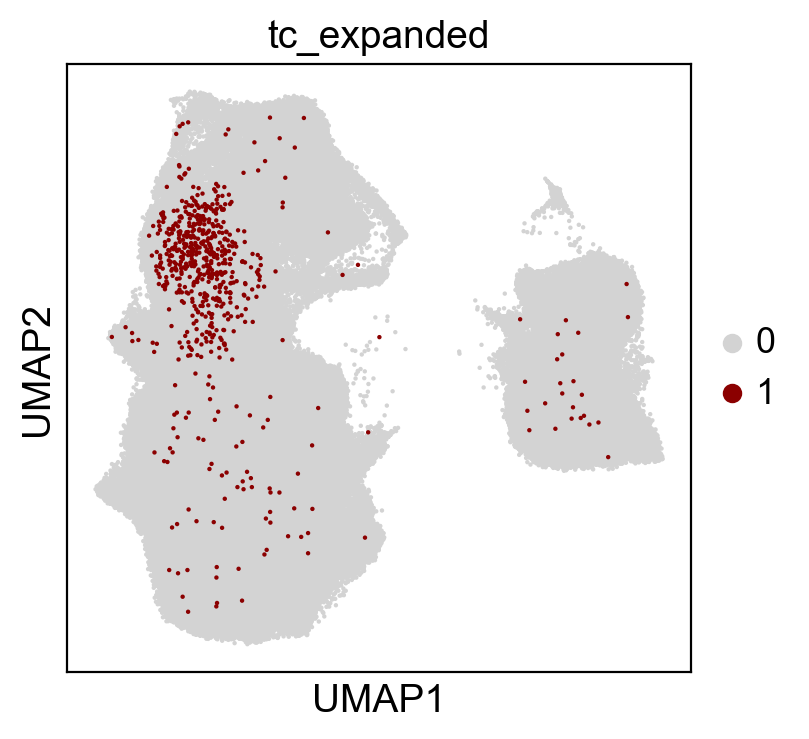

In [46]:
sc.pl.umap(adata[adata.obs.tc_expanded.argsort()], color='tc_expanded', size = 10, palette=["lightgray","darkred"])
sc.pl.umap(adata[adata.obs.tc_expanded.argsort()], color='tc_expanded', size=10, edgecolor="none", save=".tcr_tc_expansion.png", palette=["lightgray","darkred"])

saving figure to file ./figures.V6/umap.tcr_tc_alpha_expansion.png


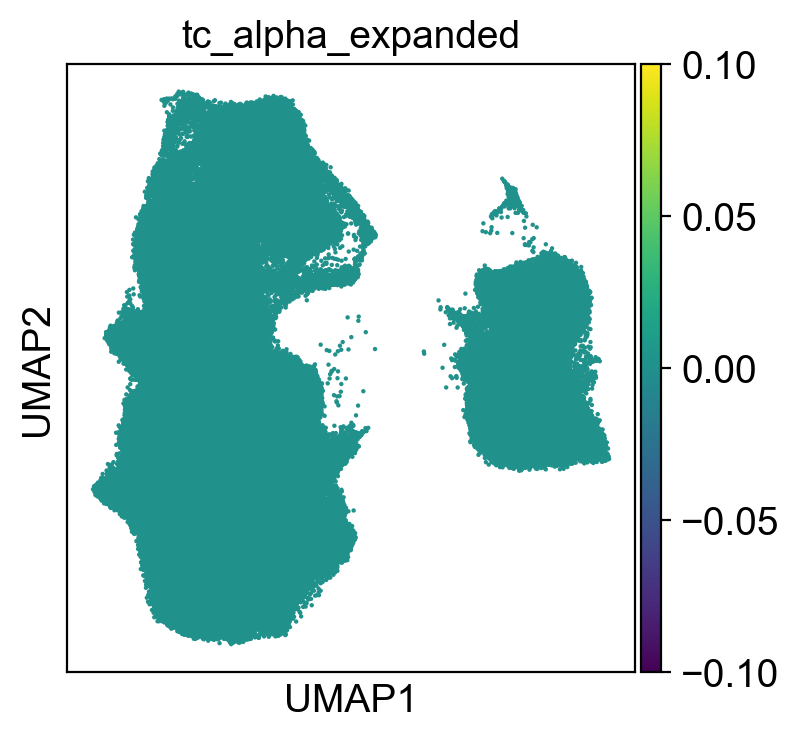

In [47]:
sc.pl.umap(adata, color='tc_alpha_expanded', size = 10)
sc.pl.umap(adata, color='tc_alpha_expanded', size=10, edgecolor="none", save=".tcr_tc_alpha_expansion.png")

In [48]:
sum((adata.obs.disease_cov=="sle") & (adata.obs.tcr==1))/sum(adata.obs.disease_cov=="sle")

0.0738559343307561

In [49]:
sum((adata.obs.disease_cov=="healthy") & (adata.obs.tcr==1))/sum(adata.obs.disease_cov=="healthy")

0.03998622001397407

In [50]:
sum((adata.obs.disease_cov=="sle") & (adata.obs.ct_cov=="T8em cyto1") & (adata.obs.tcr==1))/sum((adata.obs.disease_cov=="sle") & (adata.obs.ct_cov=="T8em cyto1"))

0.07923380281690141

In [51]:
sum((adata.obs.disease_cov=="healthy") & (adata.obs.ct_cov=="T8em cyto1") & (adata.obs.tcr==1))/sum((adata.obs.disease_cov=="healthy") & (adata.obs.ct_cov=="T8em cyto1"))

0.026953917495894115

In [67]:
obs_healthy_broad = adata.obs[adata.obs.batch_cov.str.contains("immvar") & (adata.obs.disease_cov=="healthy")]
obs_healthy_ucsf = adata.obs[~adata.obs.batch_cov.str.contains("immvar") & (adata.obs.disease_cov=="healthy")]
obs_sle = adata.obs[(adata.obs.disease_cov=="sle")]

obs_lupus_batch = adata.obs[adata.obs.batch_cov.str.contains("lupus")]
obs_immvar_batch = adata.obs[adata.obs.batch_cov.str.contains("immvar")]


In [53]:
obs_healthy_broad.shape[0]

125008

In [54]:
print("healthy broad: ", sum(obs_healthy_broad.tcr==1)/obs_healthy_broad.shape[0])
print("healthy ucsf: ", sum(obs_healthy_ucsf.tcr==1)/obs_healthy_ucsf.shape[0])
print("sle: ", sum(obs_sle.tcr==1)/obs_sle.shape[0])

healthy broad:  0.0118712402406246
healthy ucsf:  0.08332922257300711
sle:  0.0738559343307561


In [55]:
sum(obs_healthy_broad.ct_cov=="T8em cyto1")

7243

In [56]:
sum(obs_healthy_ucsf.ct_cov=="T8em cyto1")

3108

In [57]:
sum(obs_sle.ct_cov=="T8em cyto1")

44375

In [58]:
print("healthy broad: ", sum((obs_healthy_broad.tcr==1) & (obs_healthy_broad.ct_cov == "T8em cyto1"))/sum(obs_healthy_broad.ct_cov=="T8em cyto1"))
print("healthy ucsf: ", sum((obs_healthy_ucsf.tcr==1) & (obs_healthy_ucsf.ct_cov =="T8em cyto1"))/sum(obs_healthy_ucsf.ct_cov == "T8em cyto1"))
print("sle: ", sum((obs_sle.tcr==1) & (obs_sle.ct_cov=="T8em cyto1"))/sum(obs_sle.ct_cov=="T8em cyto1"))

healthy broad:  0.007869667264945465
healthy ucsf:  0.07142857142857142
sle:  0.07923380281690141


In [60]:
print("healthy broad T4: ", sum((obs_healthy_broad.tcr==1) & obs_healthy_broad.ct_cov.str.contains("T4"))/sum(obs_healthy_broad.ct_cov.str.contains("T4")))
print("healthy broad T8: ", sum((obs_healthy_broad.tcr==1) & obs_healthy_broad.ct_cov.str.contains("T8"))/sum(obs_healthy_broad.ct_cov.str.contains("T8")))

print("healthy ucsf T4: ", sum((obs_healthy_ucsf.tcr==1) & obs_healthy_ucsf.ct_cov.str.contains("T4"))/sum(obs_healthy_ucsf.ct_cov.str.contains("T4")))
print("healthy ucsf T8: ", sum((obs_healthy_ucsf.tcr==1) & obs_healthy_ucsf.ct_cov.str.contains("T8"))/sum(obs_healthy_ucsf.ct_cov.str.contains("T8")))

print("sle T4: ", sum((obs_sle.tcr==1) & obs_sle.ct_cov.str.contains("T4"))/sum(obs_sle.ct_cov.str.contains("T4")))
print("sle T8: ", sum((obs_sle.tcr==1) & obs_sle.ct_cov.str.contains("T8"))/sum(obs_sle.ct_cov.str.contains("T8")))

# print("healthy ucsf: ", sum(obs_healthy_ucsf.tcr==1)/obs_healthy_ucsf.shape[0])
# print("sle: ", sum(obs_sle.tcr==1)/obs_sle.shape[0])

healthy broad T4:  0.013492642326998155
healthy broad T8:  0.00947527888720562
healthy ucsf T4:  0.1025539160045403
healthy ucsf T8:  0.08815716934796772
sle T4:  0.10226217564768425
sle T8:  0.0866875189975193


In [65]:
obs_lupus_batch

,disease_cov,ct_cov,pop_cov,ind_cov,well,batch_cov,batch,percent_mito,n_counts,SLEDAI,Broad,Female,PF4,SDPR,GNG11,PPBP,PC2,PC29,PC32,louvain,leiden,disease_pop_cov,site,disease_pop_site_cov,umap_density_disease_pop_site_cov,tcr,nkt,mait,tc_expanded,tc_alpha_expanded,tc_beta_expanded,th_alpha_expanded,th_beta_expanded,th_expanded
index,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,,


In [68]:
print("lupus batch T4: ", sum((obs_lupus_batch.tcr==1) & obs_lupus_batch.ct_cov.str.contains("T4"))/sum(obs_lupus_batch.ct_cov.str.contains("T4")))
print("lupus batch T8: ", sum((obs_lupus_batch.tcr==1) & obs_lupus_batch.ct_cov.str.contains("T8"))/sum(obs_lupus_batch.ct_cov.str.contains("T8")))

print("immvar batch T4: ", sum((obs_immvar_batch.tcr==1) & obs_immvar_batch.ct_cov.str.contains("T4"))/sum(obs_immvar_batch.ct_cov.str.contains("T4")))
print("immvar batch T8: ", sum((obs_immvar_batch.tcr==1) & obs_immvar_batch.ct_cov.str.contains("T8"))/sum(obs_immvar_batch.ct_cov.str.contains("T8")))

# print("healthy ucsf: ", sum(obs_healthy_ucsf.tcr==1)/obs_healthy_ucsf.shape[0])
# print("sle: ", sum(obs_sle.tcr==1)/obs_sle.shape[0])

lupus batch T4:  0.10233933489939434
lupus batch T8:  0.08692799737575857
immvar batch T4:  0.013492642326998155
immvar batch T8:  0.00947527888720562


In [73]:
len(obs_lupus_batch.ind_cov[obs_lupus_batch.disease_cov=="sle"].unique())
len(obs_lupus_batch.ind_cov[obs_lupus_batch.disease_cov=="healthy"].unique())

22

In [81]:
len(obs_healthy_ucsf.ind_cov[obs_healthy_ucsf.tc_expanded==1].unique())
len(obs_sle.ind_cov[obs_sle.tc_expanded==1].unique())

48

In [59]:
sum((adata.obs.disease_cov=="healthy") & (adata.obs.ct_cov=="T8em cyto1") & (adata.obs.tcr==1))/sum((adata.obs.disease_cov=="healthy") & (adata.obs.ct_cov=="T8em cyto1"))

0.026953917495894115

# let's do WLS as a total number of PBMCs

In [118]:
joined_pivot = pd.read_csv("CLUESImmVar_processed."+version+'_joined_pivot_ct_perc.txt',index_col=False)


In [119]:
joined_pivot.shape

(188, 71)

In [120]:
## Make proportion plots (Fig. 1D)

##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
adata_obs_small = adata.obs;##[(adata.obs.batch_cov.str.contains("lupus"))]

##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

## no batch_cov so that we aggregate the count for the two healthy controls
ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov','site','disease_pop_site_cov'])['ct_cov'].count()

##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

##ind_count = ind_count.reset_index(name="counts")
ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
ind_count_sums = ind_count_sums.reset_index(name="counts")

##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
ind_count = ind_count.reset_index(name="ct_count")

## filter samples that have < 100 cells
ind_count = ind_count[ind_count.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


ind_count.ind_cov = ind_count.ind_cov.apply(lambda x: x.split('_')[0])
ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
ind_count.ind_cov = ind_count.ind_cov.astype("str")
ind_count.batch_cov = ind_count.batch_cov.astype("str")
ind_count.reset_index(inplace=True)
ind_count.ct_cov = ind_count.ct_cov.astype('category')
ind_count.ct_cov = ind_count.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)

ind_count = ind_count.join(joined_pivot.set_index(["ind_cov", 'disease_cov', 'batch_cov','disease_pop_site_cov']), on=["ind_cov", 'disease_cov', 'batch_cov','disease_pop_site_cov'])
ind_count = ind_count[~np.isnan(ind_count.pbmc_counts)]

ind_perc = ind_count;
ind_perc["ct_perc"] = ind_count.ct_count/ind_count.pbmc_counts*100


In [121]:
print("ind_count.shape: ",ind_count.shape)
print("ind_count_sums.shape: ", ind_count_sums.shape)
print("len(ind_count.ind_cov): ", len(ind_count.ind_cov))
print("len(ind_count.ind_cov.unique): ", len(ind_count.ind_cov.unique()))

## for now, let's filter out one of the reps for the healthies from UCSF only
## and filter out any broad samples that were replicated at UCSF
ind_perc_broad = ind_perc[~ind_perc.batch_cov.str.contains("lupus")]
ind_perc_ucsf = ind_perc[ind_perc.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
ind_perc_all = ind_perc_ucsf.append(ind_perc_broad);

ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
ind_count_sums_all = ind_count_sums_ucsf.append(ind_count_sums_broad);

ind_count.shape:  (3465, 77)
ind_count_sums.shape:  (206, 3)
len(ind_count.ind_cov):  3465
len(ind_count.ind_cov.unique):  169


## plot the figures

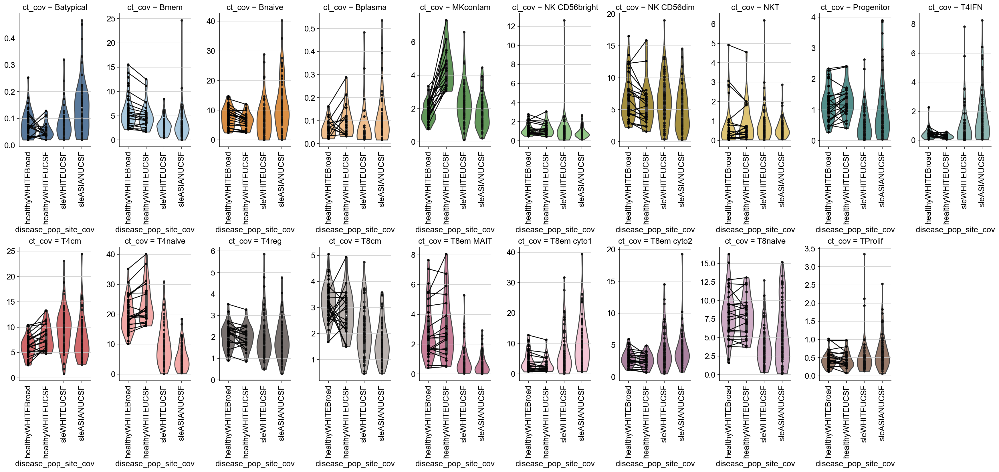

In [127]:
##plt.figure(figsize=(20,8))

ind_perc_all['site'] = pd.Categorical(ind_perc_all.disease_cov, categories=['Broad','UCSF'])
ind_perc_all.site[ind_perc_all.batch_cov.str.contains("immvar")] = "Broad"
ind_perc_all.site[~ind_perc_all.batch_cov.str.contains("immvar")] = "UCSF"

ind_perc_all['disease_pop_cov'] = pd.Categorical(ind_perc_all.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1),
                                             categories=['healthyWHITE','sleWHITE','sleASIAN'],
                                             ordered=True)

ind_perc_all['disease_pop_site_cov'] = pd.Categorical(ind_perc_all.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
                                             categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
                                             ordered=True)


plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc_all, kind='violin', col='ct_cov', 
                dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
               palette = ["#4E79A7","#A0CBE8","#F28E2B","#FFBE7D","#59A14F","#8CD17D","#B6992D","#F1CE63","#499894","#86BCB6","#E15759","#FF9D9A","#79706E","#BAB0AC","#D37295","#FABFD2","#B07AA1","#D4A6C8","#9D7660","#D7B5A6"]) #, palette=sc.pl.palettes.vega_20_scanpy
plot.set_xticklabels(rotation=90)
plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

for ct_i in list(range(len(ind_perc_all.ct_cov.cat.categories))) :
    ct = ind_perc_all.ct_cov.cat.categories[ct_i]
    
    sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc_all[ind_perc_all.ct_cov == ct], color="0", scale=0.5,
                 ax=plot.axes[ct_i], legend=False)
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)
    plot.axes[ct_i].get_legend().remove()
    
    plot.axes[ct_i].get_yaxis().label.set_visible(False)

plot.savefig(figdir+"/violin.lymphoid.png")


## weighted least squares using total pbmc counts

In [123]:
# ##cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'dc','dc', 'mk', 'progen']})
# ind_count_all = ind_count_all[~np.isnan(ind_count_all.pbmc_counts)]
# ind_perc_all = ind_perc_all[~np.isnan(ind_count_all.pbmc_counts)]


ind_count = ind_count_all.drop_duplicates(subset=['ct_cov','ind_cov']);
ind_count_sums = ind_count_sums_all.drop_duplicates(subset=['ind_cov']);
ind_perc = ind_perc.drop_duplicates(subset=['ct_cov','ind_cov']);

##ind_count = ind_count.join(joined_pivot.set_index(["ind_cov", 'disease_cov', 'batch_cov']), on=["ind_cov", 'disease_cov', 'batch_cov'])

## let's remove the nan entries. these are likely due to small cell numbers
# ind_count = ind_count[~np.isnan(ind_count.pbmc_counts)]
# ind_perc = ind_count;
# ind_perc["ct_perc"] = ind_count.ct_count/ind_count.pbmc_counts*100

In [126]:
print('as a proportion of total PBMC ')

all_out = pd.DataFrame()

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
    disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc[ind_perc.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    ##r2=est.rsquared
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(all_out);

print('\nwhite sle vs white healthy')

white_out = pd.DataFrame();

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[ind_perc.pop_cov=="WHITE"];
    
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)

    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    white_out = white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(white_out); ##print(white_out)

asian_sle_white_out = pd.DataFrame();
    
print('\nasian sle vs white healthy')

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))]
   
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    asian_sle_white_out = asian_sle_white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(asian_sle_white_out); ##print(white_out) 
  
print('\nwhite sle vs asian sle')

asian_white_sle_out = pd.DataFrame();

for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ind_perc_small = ind_perc[ind_perc.disease_cov=="sle"];
    
    ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
    pop = ind_perc_small.pop_cov[ind_perc_small.ct_cov==ct]
    
    pop = pop.astype("str")
    pop.values[pop=="ASIAN"] = 0
    pop.values[pop=="WHITE"] = 1
    pop = sm.add_constant(pop)
   
    ##data = data.assign(ct_perc=ct_perc)
    weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
    est=sm.WLS(ct_perc.astype(float), pop.astype(float), weights=weights)
    
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    #print(effect)
    #print(pval)
    logfc = math.log2(sum(est.params)/est.params[0])
    #print(effect)
    #print(pval)
    asian_white_sle_out = asian_white_sle_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval), "LogFC": str(logfc)}), ignore_index=True)
display(asian_white_sle_out); ##print(white_out)  

as a proportion of total PBMC 


,Beta,Cell,LogFC,Pval
0,-0.04285573549095187,Batypical,-0.6358190013713237,0.008701532961307231
1,2.7265925869174525,Bmem,0.9260874221944239,1.9598840156949566e-07
2,-2.1486639219105355,Bnaive,-0.36213153583353885,0.0883046988792446
3,-0.03165327034443906,Bplasma,-0.5794826539383741,0.15172346086731242
4,-0.10946275192180864,MKcontam,-0.07988858829011716,0.5555437006729937
5,0.19813062005853838,NK CD56bright,0.27068264275553616,0.2314522933787034
6,0.6301619464400948,NK CD56dim,0.15105621995364227,0.30832954247500494
7,-0.0528746643253232,NKT,-0.10699102329030692,0.7114041396364901
8,0.39235001440173456,Progenitor,0.5889345378422507,0.0030490183323070657
9,-0.8974384449206851,T4IFN,-1.6644252996844908,0.0005337910858013491



white sle vs white healthy


,Beta,Cell,LogFC,Pval
0,-0.006857179779985642,Batypical,-0.12249318502080946,0.5714249387981576
1,2.995588863064094,Bmem,1.0602514888422836,2.778959864775376e-09
2,0.2715394511726785,Bnaive,0.05298179975941703,0.7937406512592988
3,-0.0051580503931059046,Bplasma,-0.1117667577270515,0.8012015153907788
4,-0.4393609841458437,MKcontam,-0.29693434291512794,0.04079532527703605
5,0.07807913888708243,NK CD56bright,0.10069473572361179,0.7238378140027533
6,-0.05140012043177622,NK CD56dim,-0.011650857838150312,0.9397243956827463
7,-0.17417370318159595,NKT,-0.3260514056532381,0.36128890577470874
8,0.6067235416191654,Progenitor,1.053779887659078,1.7328723738910343e-07
9,-0.557052141564238,T4IFN,-1.2307377924092588,0.015919184816821624



asian sle vs white healthy


,Beta,Cell,LogFC,Pval
0,-0.06954959654749876,Batypical,-0.9250736589506087,0.00023415274677261174
1,2.507061119188217,Bmem,0.8251463803489079,0.000150772680296385
2,-4.156108810953644,Bnaive,-0.6340303951960072,0.003092030651148518
3,-0.044769446296764735,Bplasma,-0.764806475205659,0.04712898267125067
4,0.16889475594514616,MKcontam,0.1326564164794548,0.34312465748657406
5,0.30067422363273677,NK CD56bright,0.4336474319234805,0.005254973446588538
6,1.205242076794557,NK CD56dim,0.30423593476062977,0.06714901468310731
7,0.04947355965594201,NKT,0.10784688511249617,0.7274833778512424
8,0.20593125383707658,Progenitor,0.27913922458670193,0.18285268396078463
9,-1.1738621320264833,T4IFN,-1.9404393632750179,2.373851509177646e-05



white sle vs asian sle


,Beta,Cell,LogFC,Pval
0,-0.06269241676751315,Batypical,-0.8025804739297988,0.0006284628591562775
1,-0.4885277438758743,Bmem,-0.23510510849337582,0.3471200058113386
2,-4.427648262126322,Bnaive,-0.6870121949554238,0.0025880878108183714
3,-0.0396113959036588,Bplasma,-0.6530397174786072,0.09577064272469699
4,0.6082557400909898,MKcontam,0.4295907593945831,0.0024435328911594297
5,0.22259508474565434,NK CD56bright,0.332952696199869,0.2481666292040877
6,1.2566421972263335,NK CD56dim,0.3158867925987804,0.05920752977763016
7,0.22364726283753805,NKT,0.43389829076573433,0.09744173155691162
8,-0.4007922877820889,Progenitor,-0.7746406630723763,0.007642159187130464
9,-0.6168099904622453,T4IFN,-0.7097015708657572,0.04606751054597705


In [94]:
# ## Make proportion plots (Fig. 1D)

# ##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
# ##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
# adata_obs_small = adata.obs;##[(adata.obs.batch_cov.str.contains("lupus"))]

# ##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

# ## no batch_cov so that we aggregate the count for the two healthy controls
# ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov','site'])['ct_cov'].count()

# ##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
# ##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
# ind_count_sums = ind_count_sums.reset_index(name="counts")

# ##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ind_perc = ind_perc.reset_index(name="ct_perc")

# ## filter samples that have < 100 cells
# ind_perc = ind_perc[ind_perc.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


In [95]:
# print("ind_perc.shape: ",ind_perc.shape)
# print("ind_count_sums.shape: ", ind_count_sums.shape)
# print("len(ind_perc.ind_cov): ", len(ind_perc.ind_cov))
# print("len(ind_perc.ind_cov.unique): ", len(ind_perc.ind_cov.unique()))

# ## for now, let's filter out one of the reps for the healthies from UCSF only
# ## and filter out any broad samples that were replicated at UCSF
# ind_perc_broad = ind_perc[~ind_perc.batch_cov.str.contains("lupus")]
# ind_perc_ucsf = ind_perc[ind_perc.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
# ind_perc_all = ind_perc_ucsf.append(ind_perc_broad);

# ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
# ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
# ind_count_sums_all = ind_count_sums_ucsf.append(ind_count_sums_broad);

# print(ind_perc.shape)
# print(ind_count_sums.shape)

# ##ind_count = ind_count.drop_duplicates(subset=['ct_cov','ind_cov'])

ind_perc.shape:  (3792, 7)
ind_count_sums.shape:  (206, 3)
len(ind_perc.ind_cov):  3792
len(ind_perc.ind_cov.unique):  169
(3792, 7)
(206, 3)


In [96]:
# ##cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'dc','dc', 'mk', 'progen']})
# ind_perc_all.ind_cov = ind_perc_all.ind_cov.apply(lambda x: x.split('_')[0])
# ind_count_sums_all.ind_cov = ind_count_sums_all.ind_cov.apply(lambda x: x.split('_')[0])
# ##ind_perc_all = ind_perc_all.set_index('ct_cov').join(cg_cov.set_index('ct_cov'))
# ind_perc_all.ind_cov = ind_perc_all.ind_cov.astype("str")
# ind_perc_all.batch_cov = ind_perc_all.batch_cov.astype("str")
# ind_perc_all.reset_index(inplace=True)
# ind_perc_all.ct_cov = ind_perc_all.ct_cov.astype('category')
# ind_perc_all.ct_cov = ind_perc_all.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)
# ## do this to get monos and lympho to have similar colors as the major cell types
# ##ind_perc_all.cg_cov = ind_perc_all.cg_cov.astype('category')
# ##ind_perc_all.cg_cov = ind_perc_all.cg_cov.cat.reorder_categories(["mono", "dc", "mk", "progen","lymph"])

# ind_perc = ind_perc_all.drop_duplicates(subset=['ct_cov','ind_cov']);
# ind_count_sums = ind_count_sums_all.drop_duplicates(subset=['ind_cov']);

# ind_perc = ind_perc.join(joined_pivot.set_index(["ind_cov", 'disease_cov', 'batch_cov']), on=["ind_cov", 'disease_cov', 'batch_cov'])

# ## let's remove the nan entries. these are likely due to small cell numbers
# ind_perc = ind_perc[~np.isnan(ind_perc.pbmc_counts)]

## ordinary least squares

In [100]:

# print('as a proportion of total PBMC ')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
    
# print('\nwhite sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[ind_perc.pop_cov=="WHITE"].ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc[ind_perc.pop_cov=="WHITE"].disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
# print('\nasian sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
# print('\nwhite sle vs asian sle')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[ind_perc.disease_cov=="sle"].ct_perc[ind_perc.ct_cov==ct]
#     pop = ind_perc[ind_perc.disease_cov=="sle"].pop_cov[ind_perc.ct_cov==ct]
#     pop = pop.astype("str")
#     pop.values[pop=="ASIAN"] = 0
#     pop.values[pop=="WHITE"] = 1
#     pop = sm.add_constant(pop)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), pop.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))

as a proportion of total PBMC 
Cluster=Batypical, Beta=-0.08055548237810022, R2=0.09166327763567095, pvalue=0.0002770160023685656
Cluster=Bmem, Beta=2.57364096231547, R2=0.13431657522058105, pvalue=1.4977647183615535e-06
Cluster=Bnaive, Beta=-5.429636249610409, R2=0.06271925801687583, pvalue=0.0012192315008159812
Cluster=Bplasma, Beta=-0.06359124391082394, R2=0.02463452384602627, pvalue=0.09687452693824967
Cluster=MKcontam, Beta=0.4532109418749215, R2=0.015158099218564147, pvalue=0.11515046149397873
Cluster=NK CD56bright, Beta=-0.10044263153391939, R2=0.000741348965062838, pvalue=0.7292809753215908
Cluster=NK CD56dim, Beta=-1.4996459016223687, R2=0.014471181547627832, pvalue=0.1237847074082056
Cluster=NKT, Beta=-0.3165202778883389, R2=0.012901622983482408, pvalue=0.14757042322574143
Cluster=Progenitor, Beta=0.39912519818801195, R2=0.024642241463566417, pvalue=0.04814639481564248
Cluster=T4IFN, Beta=-1.8167286669054157, R2=0.09334215125161438, pvalue=7.702681467397866e-05
Cluster=T4cm, 

## weighted least squares using total pbmc counts

In [101]:
# print('as a proportion of total PBMC ')

# all_out = pd.DataFrame()

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc[ind_perc.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     ##r2=est.rsquared
    
#     all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(all_out);

# print('\nwhite sle vs white healthy')

# white_out = pd.DataFrame();

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[ind_perc.pop_cov=="WHITE"];
    
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)

#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
    
#     white_out = white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(white_out); ##print(white_out)

# asian_sle_white_out = pd.DataFrame();
    
# print('\nasian sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))]
   
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     asian_sle_white_out = asian_sle_white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(asian_sle_white_out); ##print(white_out) 
  
# print('\nwhite sle vs asian sle')

# asian_white_sle_out = pd.DataFrame();

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[ind_perc.disease_cov=="sle"];
    
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     pop = ind_perc_small.pop_cov[ind_perc_small.ct_cov==ct]
    
#     pop = pop.astype("str")
#     pop.values[pop=="ASIAN"] = 0
#     pop.values[pop=="WHITE"] = 1
#     pop = sm.add_constant(pop)
   
#     ##data = data.assign(ct_perc=ct_perc)
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), pop.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     asian_white_sle_out = asian_white_sle_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(asian_white_sle_out); ##print(white_out)  

as a proportion of total PBMC 


,Beta,Cell,Pval
0,-0.08499419954756501,Batypical,0.0004984947207556215
1,2.781295962873956,Bmem,6.071681946403994e-07
2,-5.574518883534031,Bnaive,0.002420932596135354
3,-0.06961745005864134,Bplasma,0.0934760653809055
4,0.2109944903391175,MKcontam,0.47459711012196004
5,-0.09341387710380802,NK CD56bright,0.7304115694972937
6,-1.6334549221500008,NK CD56dim,0.10986212460403477
7,-0.3672886996761562,NKT,0.0989252614114796
8,0.37496880245913855,Progenitor,0.08811097883097481
9,-1.8068716371566074,T4IFN,0.0002970013545272297



white sle vs white healthy


,Beta,Cell,Pval
0,-0.036033278936064304,Batypical,0.0700816857918144
1,2.829559162354496,Bmem,1.1577842344616587e-05
2,-2.1153278002554208,Bnaive,0.1684490093990761
3,-0.035960930222923376,Bplasma,0.42075340047280674
4,-0.30897778657718,MKcontam,0.38031830250664
5,-0.30738459558950276,NK CD56bright,0.39700537955416526
6,-2.9990692318056067,NK CD56dim,0.005753705602228821
7,-0.5980304871879668,NKT,0.041152479394633845
8,0.6959601009056093,Progenitor,0.00010043343402561577
9,-1.3678093615497866,T4IFN,0.006746681930395561



asian sle vs white healthy


,Beta,Cell,Pval
0,-0.12213598655805682,Batypical,7.583132080741964e-06
1,2.74193423946877,Bmem,2.8418171686508612e-05
2,-8.443602867386337,Bnaive,2.8442247945652877e-05
3,-0.08697799448613569,Bplasma,0.027012733258206814
4,0.6499894979580746,MKcontam,0.03968962052422292
5,0.08954548500845114,NK CD56bright,0.56404975796631
6,-0.4805129464216982,NK CD56dim,0.6411679615472363
7,-0.17248121230877667,NKT,0.3270423991315413
8,0.09532650539350596,Progenitor,0.7065639105888111
9,-2.1631206791001807,T4IFN,9.572465488083367e-06



white sle vs asian sle


,Beta,Cell,Pval
0,-0.08610270762199251,Batypical,0.0009064396574775385
1,-0.08762492288572762,Bmem,0.864118163780458
2,-6.328275067130917,Bnaive,0.0027131913625855902
3,-0.05101706426321234,Bplasma,0.24812058594812506
4,0.958967284535255,MKcontam,0.0005246832383446676
5,0.3969300805979542,NK CD56bright,0.212752110905579
6,2.51855628538391,NK CD56dim,0.02686461687111368
7,0.4255492748791906,NKT,0.07374408688810268
8,-0.6006335955121029,Progenitor,0.020395783821755376
9,-0.7953113175503933,T4IFN,0.17797627504914354


## let's do WLS as a total number of PBMCs

In [103]:
# ## Make proportion plots (Fig. 1D)

# ##adata_obs_small = adata.obs[(adata.obs.study_cov=="ImmVar") & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & (adata.obs.study_cov=="CLUES"))]
# ##adata_obs_small = adata.obs[(adata.obs.well.str.contains("immvar")) & (adata.obs.ind_cov.str.contains("IGTB")) | (~adata.obs.ind_cov.str.contains("IGTB") & ~adata.obs.well.str.contains("immvar"))]
# adata_obs_small = adata.obs;##[(adata.obs.batch_cov.str.contains("lupus"))]

# ##ind_count = adata_obs_small.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov','batch_cov'])['ct_cov'].count()

# ## no batch_cov so that we aggregate the count for the two healthy controls
# ind_count = adata_obs_small.groupby(['ind_cov','ct_cov','disease_cov','pop_cov','batch_cov','site'])['ct_cov'].count()

# ##ind_count = adata.obs.groupby(['ind_cov','study_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()
# ##ind_count = adata.obs.groupby(['ind_cov','ct_cov','disease_cov','pop_cov'])['ct_cov'].count()

# ##ind_count = ind_count.reset_index(name="counts")
# ind_count_sums = ind_count.groupby(["ind_cov","batch_cov"]).sum()
# ind_count_sums = ind_count_sums.reset_index(name="counts")

# ##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ##ind_perc = ind_count/ind_count.groupby(["ind_cov","batch_cov"]).transform(sum)*100
# ind_count = ind_count.reset_index(name="ct_count")

# ## filter samples that have < 100 cells
# ind_count = ind_count[ind_count.ind_cov.isin(ind_count_sums.ind_cov[ind_count_sums.counts > 100])]


In [104]:
# print("ind_count.shape: ",ind_count.shape)
# print("ind_count_sums.shape: ", ind_count_sums.shape)
# print("len(ind_count.ind_cov): ", len(ind_count.ind_cov))
# print("len(ind_count.ind_cov.unique): ", len(ind_count.ind_cov.unique()))

# ## for now, let's filter out one of the reps for the healthies from UCSF only
# ## and filter out any broad samples that were replicated at UCSF
# ind_count_broad = ind_count[~ind_count.batch_cov.str.contains("lupus")]
# ind_count_ucsf = ind_count[ind_count.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ct_cov','ind_cov'])
# ind_count_all = ind_count_ucsf.append(ind_count_broad);

# ind_count_sums_broad = ind_count_sums[~ind_count_sums.batch_cov.str.contains("lupus")]
# ind_count_sums_ucsf = ind_count_sums[ind_count_sums.batch_cov.str.contains("lupus")].drop_duplicates(subset=['ind_cov'])
# ind_count_sums_all = ind_count_sums_ucsf.append(ind_count_sums_broad);

# print(ind_count.shape)
# print(ind_count_sums.shape)

# ##ind_count = ind_count.drop_duplicates(subset=['ct_cov','ind_cov'])

ind_count.shape:  (3792, 7)
ind_count_sums.shape:  (206, 3)
len(ind_count.ind_cov):  3792
len(ind_count.ind_cov.unique):  169
(3792, 7)
(206, 3)


In [105]:
# ##cg_cov = pd.DataFrame( {'ct_cov':['B','cM','ncM', 'Th', 'Tc', 'NK', 'ProlifT', 'cDC', 'pDC', 'MK', 'Progen'], 'cg_cov':['lymph', 'mono', 'mono', 'lymph','lymph', 'lymph', 'lymph', 'dc','dc', 'mk', 'progen']})
# ind_count_all.ind_cov = ind_count_all.ind_cov.apply(lambda x: x.split('_')[0])
# ind_count_sums_all.ind_cov = ind_count_sums_all.ind_cov.apply(lambda x: x.split('_')[0])
# ##ind_perc_all = ind_perc_all.set_index('ct_cov').join(cg_cov.set_index('ct_cov'))
# ind_count_all.ind_cov = ind_count_all.ind_cov.astype("str")
# ind_count_all.batch_cov = ind_count_all.batch_cov.astype("str")
# ind_count_all.reset_index(inplace=True)
# ind_count_all.ct_cov = ind_count_all.ct_cov.astype('category')
# ind_count_all.ct_cov = ind_count_all.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)
# ## do this to get monos and lympho to have similar colors as the major cell types
# ##ind_perc_all.cg_cov = ind_perc_all.cg_cov.astype('category')
# ##ind_perc_all.cg_cov = ind_perc_all.cg_cov.cat.reorder_categories(["mono", "dc", "mk", "progen","lymph"])

# ind_count = ind_count_all.drop_duplicates(subset=['ct_cov','ind_cov']);
# ind_count_sums = ind_count_sums_all.drop_duplicates(subset=['ind_cov']);

# ind_count = ind_count.join(joined_pivot.set_index(["ind_cov", 'disease_cov', 'batch_cov']), on=["ind_cov", 'disease_cov', 'batch_cov'])

# ## let's remove the nan entries. these are likely due to small cell numbers
# ind_count = ind_count[~np.isnan(ind_count.pbmc_counts)]
# ind_perc = ind_count;
# ind_perc["ct_perc"] = ind_count.ct_count/ind_count.pbmc_counts*100

## weighted least squares using total pbmc counts

In [107]:
# print('as a proportion of total PBMC ')

# all_out = pd.DataFrame()

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc[ind_perc.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     ##r2=est.rsquared
    
#     all_out = all_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(all_out);

# print('\nwhite sle vs white healthy')

# white_out = pd.DataFrame();

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[ind_perc.pop_cov=="WHITE"];
    
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)

#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
    
#     white_out = white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(white_out); ##print(white_out)

# asian_sle_white_out = pd.DataFrame();
    
# print('\nasian sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))]
   
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     disease = ind_perc_small.disease_cov[ind_perc_small.ct_cov==ct]
    
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
    
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), disease.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     asian_sle_white_out = asian_sle_white_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(asian_sle_white_out); ##print(white_out) 
  
# print('\nwhite sle vs asian sle')

# asian_white_sle_out = pd.DataFrame();

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ind_perc_small = ind_perc[ind_perc.disease_cov=="sle"];
    
#     ct_perc = ind_perc_small.ct_perc[ind_perc_small.ct_cov==ct]
#     pop = ind_perc_small.pop_cov[ind_perc_small.ct_cov==ct]
    
#     pop = pop.astype("str")
#     pop.values[pop=="ASIAN"] = 0
#     pop.values[pop=="WHITE"] = 1
#     pop = sm.add_constant(pop)
   
#     ##data = data.assign(ct_perc=ct_perc)
#     weights = ind_perc_small[ind_perc_small.ct_cov==ct].pbmc_counts;
#     est=sm.WLS(ct_perc.astype(float), pop.astype(float), weights=weights)
    
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     asian_white_sle_out = asian_white_sle_out.append(({"Cell":str(ct),"Beta":str(effect),"Pval":str(pval)}), ignore_index=True)
# display(asian_white_sle_out); ##print(white_out)  

as a proportion of total PBMC 


,Beta,Cell,Pval
0,-0.04660550052009935,Batypical,0.007724401919445549
1,2.5848954276333918,Bmem,5.263590193053626e-11
2,-2.791721747149453,Bnaive,0.03205854284321691
3,-0.026582802352059197,Bplasma,0.24889554734822514
4,0.5504103573271134,MKcontam,0.015130846266456978
5,0.12446914833438122,NK CD56bright,0.466121011910101
6,0.04321027880173084,NK CD56dim,0.9449634562625024
7,-0.12159818361549349,NKT,0.37631783538257124
8,0.4385938985860165,Progenitor,0.001290989574844036
9,-0.9911401655711082,T4IFN,0.0002654089821215318



white sle vs white healthy


,Beta,Cell,Pval
0,-0.010321939963689502,Batypical,0.41956537572031916
1,2.6468263958681457,Bmem,1.647294623553364e-08
2,-0.35017576329679834,Bnaive,0.739628088348647
3,0.0017306973107992455,Bplasma,0.9371497896985121
4,0.23245622841881716,MKcontam,0.4016975293613818
5,0.003400938437240375,NK CD56bright,0.9880466345869101
6,-0.6763944834473116,NK CD56dim,0.3159239720517944
7,-0.25186740148130987,NKT,0.16076611473051583
8,0.6658282493402211,Progenitor,1.6817143280784593e-08
9,-0.6267828308586629,T4IFN,0.009738853278899577



asian sle vs white healthy


,Beta,Cell,Pval
0,-0.07413023374278108,Batypical,0.0002458863414190246
1,2.5343867653791485,Bmem,7.870341238281342e-08
2,-4.816761795376928,Bnaive,0.0008679639424333769
3,-0.04118733577364177,Bplasma,0.08167104674171746
4,0.8188482749606435,MKcontam,0.0009411855190340553
5,0.2279906143163487,NK CD56bright,0.03197287490307405
6,0.6507482420939715,NK CD56dim,0.3214999645771971
7,-0.011616288756269088,NKT,0.9252513234884825
8,0.2406310998289647,Progenitor,0.12439377920997977
9,-1.2867746544076293,T4IFN,8.377764765297e-06



white sle vs asian sle


,Beta,Cell,Pval
0,-0.06380829377909156,Batypical,0.0006460565643634664
1,-0.11243963048899844,Bmem,0.7345754884476745
2,-4.466586032080131,Bnaive,0.003020329342293277
3,-0.042918033084441025,Bplasma,0.07449176965010787
4,0.5863920465418265,MKcontam,0.004320215799641105
5,0.22458967587910852,NK CD56bright,0.2584902681395798
6,1.327142725541284,NK CD56dim,0.050416040059824904
7,0.24025111272504102,NKT,0.08376930716567144
8,-0.42519714951125626,Progenitor,0.005868266524280219
9,-0.659991823548966,T4IFN,0.03808328693918057


In [102]:
# ind_perc.ind_cov = ind_perc.ind_cov.apply(lambda x: x.split('_')[0])
# ind_count_sums.ind_cov = ind_count_sums.ind_cov.apply(lambda x: x.split('_')[0])
# ind_perc.ind_cov = ind_perc.ind_cov.astype("str")
# ind_perc.batch_cov = ind_perc.batch_cov.astype("str")
# ind_perc.reset_index(inplace=True)
# ind_perc.ct_cov = ind_perc.ct_cov.astype('category')
# ind_perc.ct_cov = ind_perc.ct_cov.cat.reorder_categories(adata.obs.ct_cov.cat.categories.values)
# ## do this to get monos and lympho to have similar colors as the major cell types

# ind_perc['site'] = pd.Categorical(ind_perc.disease_cov, categories=['Broad','UCSF'])
# ind_perc.site[ind_perc.batch_cov.str.contains("immvar")] = "Broad"
# ind_perc.site[~ind_perc.batch_cov.str.contains("immvar")] = "UCSF"

# ind_perc['disease_pop_site_cov'] = pd.Categorical(ind_perc.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)


# print('as a proportion of total PBMC ')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc.ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc.disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
    
# print('\nwhite sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[ind_perc.pop_cov=="WHITE"].ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc[ind_perc.pop_cov=="WHITE"].disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
# print('\nasian sle vs white healthy')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].ct_perc[ind_perc.ct_cov==ct]
#     disease = ind_perc[((ind_perc.pop_cov=="WHITE") & (ind_perc.disease_cov=="healthy")) | ((ind_perc.pop_cov=="ASIAN") & (ind_perc.disease_cov=="sle"))].disease_cov[ind_perc.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
    
# print('\nwhite sle vs asian sle')

# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = ind_perc[ind_perc.disease_cov=="sle"].ct_perc[ind_perc.ct_cov==ct]
#     pop = ind_perc[ind_perc.disease_cov=="sle"].pop_cov[ind_perc.ct_cov==ct]
#     pop = pop.astype("str")
#     pop.values[pop=="ASIAN"] = 0
#     pop.values[pop=="WHITE"] = 1
#     pop = sm.add_constant(pop)
#     ##data = data.assign(ct_perc=ct_perc)
#     est=sm.OLS(ct_perc.astype(float), pop.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     #print(effect)
#     #print(pval)
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))

In [129]:
# ##plt.figure(figsize=(20,8))
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', 
#                 dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
#                palette = ["#4E79A7","#A0CBE8","#F28E2B","#FFBE7D","#59A14F","#8CD17D","#B6992D","#F1CE63","#499894","#86BCB6","#E15759","#FF9D9A","#79706E","#BAB0AC","#D37295","#FABFD2","#B07AA1","#D4A6C8","#9D7660","#D7B5A6"]) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

# for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
    
#     sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc[ind_perc.ct_cov == ct], color="0", scale=0.5,
#                  ax=plot.axes[ct_i], legend=False)
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)
#     plot.axes[ct_i].get_legend().remove()
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)

# plot.savefig(figdir+"/violin.lymph.png")
# #plt.subplots_adjust(wspace=0.03)

In [130]:
# ##plt.figure(figsize=(20,8))
# plot=sb.catplot(x='disease_pop_site_cov', y='ct_perc', hue='ct_cov', data=ind_perc, kind='violin', col='ct_cov', 
#                 dodge=False, aspect=0.5, height=5, sharex=False, sharey=False, cut=0, col_wrap=10,
#                palette = ["#4E79A7","#A0CBE8","#F28E2B","#FFBE7D","#59A14F","#8CD17D","#B6992D","#F1CE63","#499894","#86BCB6","#E15759","#FF9D9A","#79706E","#BAB0AC","#D37295","#FABFD2","#B07AA1","#D4A6C8","#9D7660","#D7B5A6"]) #, palette=sc.pl.palettes.vega_20_scanpy
# plot.set_xticklabels(rotation=90)
# plot.fig.subplots_adjust(wspace=0.4, hspace=0.75)

# for ct_i in list(range(len(ind_perc.ct_cov.cat.categories))) :
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
    
#     sb.pointplot(x="disease_pop_site_cov", y="ct_perc", hue = "ind_cov", data=ind_perc[ind_perc.ct_cov == ct], color="0", scale=0.5,
#                  ax=plot.axes[ct_i], legend=False)
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)
#     plot.axes[ct_i].get_legend().remove()
    
#     plot.axes[ct_i].get_yaxis().label.set_visible(False)

# plot.savefig(figdir+"/violin.lymph.png")
# #plt.subplots_adjust(wspace=0.03)

In [64]:
# ## Let's grab the clinical and labs data and compare to our single cell estimates
# clues_clinical = pd.read_table("v2.clinical.data.txt", index_col=False)
# clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
# clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
# joined = ind_perc.join(ind_count_sums.set_index(['ind_cov','batch_cov']), on=['ind_cov','batch_cov']);
# joined = joined.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

# t1_labs = pd.read_table("T1labs.csv",sep=",")
# t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
# joined = joined.join(t1_labs.set_index('SubjectID'), on='subjectid')

# ### test new code
# joined.AbsBaso = joined.AbsBaso/1000
# joined.AbsEosino = joined.AbsEosino/1000
# joined.AbsLympho = joined.AbsLympho/1000
# joined.AbsNeutro = joined.AbsNeutro/1000
# joined.AbsMono = joined.AbsMono/1000

# joined = joined.assign(pbmc = joined.WhiteBloodCell-joined.AbsNeutro-joined.AbsEosino-joined.AbsBaso)

# ##joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

# ## now let's add in white blood cell counts for the immvar patients
# immvar_pbmc = pd.read_table("immvar.pbmc.csv", index_col=False, sep=",")
# immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined.pbmc))

# ## this is not the most efficient code but will suffice for now
# for i in list(range(12)) :
#     igtb = immvar_pbmc.immvarid[i]
#     joined.pbmc[joined.ind_cov==igtb] = immvar_pbmc.pbmc[i]

# joined.pbmc = joined.pbmc.fillna(0)
# joined = joined.assign(estimate=joined.ct_perc/100*joined.pbmc)

# joined['disease_pop_cov'] = joined.apply(lambda row: row['disease_cov'] + row['pop_cov'], axis=1)
# joined['disease_pop_site_cov'] = pd.Categorical(joined.apply(lambda row: row['disease_cov'] + row['pop_cov'] + row['site'], axis=1),
#                                              categories=['healthyWHITEBroad','healthyWHITEUCSF','sleWHITEUCSF','sleASIANUCSF'],
#                                              ordered=True)

# joined[["ind_cov","disease_cov","ct_cov","disease_pop_cov","disease_pop_site_cov"]] = joined[["ind_cov","disease_cov","ct_cov","disease_pop_cov","disease_pop_site_cov"]].astype('str')
# joined.plaquenilnow = joined.plaquenilnow.fillna(0)
# joined.cellceptnow = joined.cellceptnow.fillna(0)
# joined.steroralnow = joined.steroralnow.fillna(0)
# joined.acrlymphopenia = joined.acrlymphopenia.fillna(0)
# joined.sledaiscore = joined.sledaiscore.fillna(0)
# joined.WhiteBloodCell = joined.WhiteBloodCell.fillna(0)
# joined.AbsMono = joined.AbsMono.fillna(0)
# joined.AbsLympho = joined.AbsLympho.fillna(0)
# joined.AbsNeutro = joined.AbsNeutro.fillna(0)
# joined.AbsEosino = joined.AbsEosino.fillna(0)
# joined.AbsBaso = joined.AbsBaso.fillna(0)
# joined.PlatCount = joined.PlatCount.fillna(0)
# joined.pbmc = joined.pbmc.fillna(0)
# joined.subjectid = joined.subjectid.fillna(0)
# joined.CreatinineUrine = joined.CreatinineUrine.fillna(0)
# joined.ProteinUrine = joined.CreatinineUrine.fillna(0)
# joined.ProCreatRatio = joined.ProCreatRatio.fillna(0)
# joined.CreatinineSerum = joined.CreatinineSerum.fillna(0)
# joined.antidsDNANum = joined.antidsDNANum.fillna(0)
# joined.C3Num = joined.C3Num.fillna(0)
# joined.ANATiter1 = joined.ANATiter1.fillna(0)

# joined_pivot = joined.pivot_table(index=['ind_cov',"disease_pop_site_cov","disease_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
# joined_pivot.reset_index(inplace=True)
# joined_pivot.to_csv("CLUESImmVarLymph."+version+"_joined_pivot_ct_estimates.txt")

# joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
# ##joined_pivot.disease_pop_site_cov = pd.Categorical(joined_pivot.disease_pop_site_cov,categories=['healthy','sle'], ordered=True)

# joined_pivot_perc = joined.pivot_table(index=['ind_cov',"disease_pop_site_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="ct_perc")
# joined_pivot_perc.reset_index(inplace=True)
# joined_pivot_perc.to_csv("CLUESImmVarLymph."+version+"_joined_pivot_ct_perc.txt")

# ##joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
# ##joined_pivot.disease_cov = pd.Categorical(joined_pivot.disease_cov,categories=['healthy','sle'], ordered=True)

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: FutureWarning: read_table is deprecated, use read_csv instead, passing sep='\t'.
  
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:8: FutureWarning: read_table is deprecated, use read_csv instead.
  
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:24: FutureWarning: read_table is deprecated, use read_csv instead.
/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy


In [65]:
# ind_perc[abs(ct_percs.ct_percs-ind_perc.ct_perc) > 1e-5].head()
# sum(ind_perc.ct_perc[ind_perc.ind_cov=="IGTB141"])
# sum(ct_percs.ct_percs[ct_percs.ind_cov=="IGTB141"])

# #get counts of cells for each cluster
# ct_counts=adata.obs.groupby(['ind_cov', 'disease_cov', 'disease_pop_site_cov','ct_cov'])['ct_cov'].count()
# ct_percs = ct_counts/ct_counts.groupby(level=[0]).transform(sum)*100
# ct_percs = ct_percs.reset_index(name='ct_percs')
# ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
# ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
# ct_percs.reset_index(inplace=True)
# ct_percs.ct_cov = ct_percs.ct_cov.astype("category")
# ct_df=ct_percs.unstack(level=2, fill_value=0)

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))) :
#     ct = ct_percs.ct_cov.cat.categories[ct_i]
#     ct_perc = ct_percs.ct_percs[ct_percs.ct_cov==ct]
#     disease = ct_percs.disease_cov[ct_percs.ct_cov==ct]
#     disease = disease.astype("str")
#     disease.values[disease=="sle"] = 0
#     disease.values[disease=="healthy"] = 1
#     disease = sm.add_constant(disease)
#     ##data = data.assign(ct_perc=ct_perc)
#     ##print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), disease.astype(float))
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     r2=est.rsquared
#     print('Cluster='+str(ct)+', Beta='+str(effect)+', R2='+str(r2)+', pvalue='+str(pval))
    
# # #box plot as a proportion of cell type
# # vars=[str(x) for x in list(range(n_cts))]
# # ct_df['ind_cov']=ct_df.index.get_level_values('ind_cov').tolist()
# # ct_df.index=ct_df['ind_cov']
# # melted=pd.melt(ct_df, id_vars=['ind_cov', 'disease'], value_vars=vars)

# # #plot=sb.boxplot(x='disease', y='value', hue=ct_arg, data=melted).get_figure()
# # plt.figure(figsize=(15,8))
# # plot=sb.catplot(x='disease_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=0.4, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy)
# # plot.savefig(figdir+"/violin.ct_cov.png")
# # #plt.subplots_adjust(wspace=0.03)

In [131]:
# ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
# ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
# joined2 = ifn.join(joined.set_index("ind_cov"), on="name")

# joined_pivot2 = joined2.pivot_table(index=['name',"disease_pop_site_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
# joined_pivot2.reset_index(inplace=True)

# ##print(joined_pivot2[joined_pivot2.pbmc < 0])
# joined_pivot2 = joined_pivot2[joined_pivot2.pbmc > 0]

# ##print(joined_pivot2[joined_pivot2.pbmc > 10])
# joined_pivot2 = joined_pivot2[joined_pivot2.pbmc < 10]

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = joined_pivot2[ct]
#     ifn = joined_pivot2.ifn
#     ifn = sm.add_constant(ifn)
#     ##print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))

In [68]:
# ## Let's grab the clinical and labs data and compare to our single cell estimates
# clues_clinical = pd.read_table("v2.clinical.data.txt", index_col=False)
# clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
# clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
# joined_cd4 = ct_percs_cd4.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

# t1_labs = pd.read_table("T1labs.csv",sep=",")
# t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
# joined_cd4 = joined_cd4.join(t1_labs.set_index('SubjectID'), on='subjectid')

# ### test new code
# joined_cd4.AbsBaso = joined_cd4.AbsBaso/1000
# joined_cd4.AbsEosino = joined_cd4.AbsEosino/1000
# joined_cd4.AbsLympho = joined_cd4.AbsLympho/1000
# joined_cd4.AbsNeutro = joined_cd4.AbsNeutro/1000
# joined_cd4.AbsMono = joined_cd4.AbsMono/1000

# joined_cd4 = joined_cd4.assign(pbmc = joined_cd4.WhiteBloodCell-joined_cd4.AbsNeutro-joined_cd4.AbsEosino-joined_cd4.AbsBaso)

# joined_cd4[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined_cd4[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

# ## now let's add in white blood cell counts for the immvar patients
# immvar_pbmc = pd.read_table("immvar.pbmc.csv", index_col=False, sep=",")
# immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined_cd4.pbmc))

# ## this is not the most efficient code but will suffice for now
# for i in list(range(12)) :
#     igtb = immvar_pbmc.immvarid[i]
#     joined_cd4.pbmc[joined_cd4.ind_cov==igtb] = immvar_pbmc.pbmc[i]

# joined_cd4 = joined_cd4.assign(estimate=joined_cd4.ct_percs/100*joined_cd4.pbmc)

# joined_cd4[["ind_cov","disease_cov","leiden"]] = joined_cd4[["ind_cov","disease_cov","leiden"]].astype(str)
# joined_cd4.plaquenilnow = joined_cd4.plaquenilnow.fillna(0)
# joined_cd4.cellceptnow = joined_cd4.cellceptnow.fillna(0)
# joined_cd4.steroralnow = joined_cd4.steroralnow.fillna(0)
# joined_cd4.acrlymphopenia = joined_cd4.acrlymphopenia.fillna(0)

# joined_cd4_pivot = joined_cd4.pivot_table(index=['ind_cov',"disease_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="estimate")
# joined_cd4_pivot.reset_index(inplace=True)
# joined_cd4_pivot = joined_cd4_pivot[joined_cd4_pivot.pbmc > 0]
# joined_cd4_pivot.disease_cov = pd.Categorical(joined_cd4_pivot.disease_cov,categories=['healthy','sle'], ordered=True)


In [69]:
# ## Let's grab the clinical and labs data and compare to our single cell estimates
# clues_clinical = pd.read_table("v2.clinical.data.txt", index_col=False)
# clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
# clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
# joined_cd8 = ct_percs_cd8.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

# t1_labs = pd.read_table("T1labs.csv",sep=",")
# t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
# joined_cd8 = joined_cd8.join(t1_labs.set_index('SubjectID'), on='subjectid')

# ### test new code
# joined_cd8.AbsBaso = joined_cd8.AbsBaso/1000
# joined_cd8.AbsEosino = joined_cd8.AbsEosino/1000
# joined_cd8.AbsLympho = joined_cd8.AbsLympho/1000
# joined_cd8.AbsNeutro = joined_cd8.AbsNeutro/1000
# joined_cd8.AbsMono = joined_cd8.AbsMono/1000

# joined_cd8 = joined_cd8.assign(pbmc = joined_cd8.WhiteBloodCell-joined_cd8.AbsNeutro-joined_cd8.AbsEosino-joined_cd8.AbsBaso)

# joined_cd8[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined_cd8[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

# ## now let's add in white blood cell counts for the immvar patients
# immvar_pbmc = pd.read_table("immvar.pbmc.csv", index_col=False, sep=",")
# immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined_cd8.pbmc))

# ## this is not the most efficient code but will suffice for now
# for i in list(range(12)) :
#     igtb = immvar_pbmc.immvarid[i]
#     joined_cd8.pbmc[joined_cd8.ind_cov==igtb] = immvar_pbmc.pbmc[i]

# joined_cd8 = joined_cd8.assign(estimate=joined_cd8.ct_percs/100*joined_cd8.pbmc)

# joined_cd8[["ind_cov","disease_cov","leiden"]] = joined_cd8[["ind_cov","disease_cov","leiden"]].astype(str)
# joined_cd8.plaquenilnow = joined_cd8.plaquenilnow.fillna(0)
# joined_cd8.cellceptnow = joined_cd8.cellceptnow.fillna(0)
# joined_cd8.steroralnow = joined_cd8.steroralnow.fillna(0)
# joined_cd8.acrlymphopenia = joined_cd8.acrlymphopenia.fillna(0)

# joined_cd8_pivot = joined_cd8.pivot_table(index=['ind_cov',"disease_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="estimate")
# joined_cd8_pivot.reset_index(inplace=True)
# joined_cd8_pivot = joined_cd8_pivot[joined_cd8_pivot.pbmc > 0]
# joined_cd8_pivot.disease_cov = pd.Categorical(joined_cd8_pivot.disease_cov,categories=['healthy','sle'], ordered=True)


In [70]:
# fig,ax = plt.subplots(nrows=1,ncols=8, figsize=(20,5))
# fig.tight_layout()

# for ct_i in list(range(0,8)):
#     ct = ct_percs.leiden.cat.categories[ct_i]
#     sb.boxplot(x="disease_cov", y=ct, data=joined_pivot, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
#     sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])

# Let's look at the IFN score now

## look at the cell type percentage estimates on interferon

In [137]:
ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(ind_perc.set_index("ind_cov"), on="name")

joined2["disease_pop_site_cov"] = joined2["disease_pop_site_cov"].astype(str)
joined2["ct_cov"] = joined2["ct_cov"].astype(str)

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead.
  """Entry point for launching an IPython kernel.


In [138]:
joined_pivot2_percs = joined2.pivot_table(index=['name',"disease_pop_site_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="ct_perc")
joined_pivot2_percs.reset_index(inplace=True)

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc < 0])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc > 0]

##print(joined_pivot2_percs[joined_pivot2_percs.pbmc > 10])
joined_pivot2_percs = joined_pivot2_percs[joined_pivot2_percs.pbmc < 10]


all_ifn_out = pd.DataFrame();

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=joined_pivot2_percs.ifn.corr(joined_pivot2_percs[ct])
    
    all_ifn_out = all_ifn_out.append({'Cluster': str(ct), 'Beta': str(effect), 'R2': str(r2), 'pvalue': str(pval), 'cor': str(cor)}, ignore_index=True)
display(all_ifn_out)

  
sle_ifn_out = pd.DataFrame();

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(adata.obs.ct_cov.cat.categories))):
    ct = ind_perc.ct_cov.cat.categories[ct_i]
    ##ct_perc = joined_pivot2_percs[ct]
    ifn = joined_pivot2_percs.ifn
    ifn = sm.add_constant(ifn)
    
    sle_only = joined_pivot2_percs[joined_pivot2_percs.disease_pop_site_cov.str.contains("sle")]
    
    ##print('Cluster type:'+ ct)
    est=sm.OLS(sle_only[ct].astype(float), sm.add_constant(sle_only.ifn).astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    r2=est.rsquared
    cor=sle_only.ifn.corr(sle_only[ct])
    sle_ifn_out = sle_ifn_out.append({'Cluster': str(ct), 'Beta': str(effect), 'R2': str(r2), 'pvalue': str(pval), 'cor': str(cor)}, ignore_index=True)
display(sle_ifn_out)


as a proportion of cell type


,Beta,Cluster,R2,cor,pvalue
0,0.004433565466023519,Batypical,0.07046636216202273,0.26545500967588226,0.004673291435405703
1,-0.10466416920924015,Bmem,0.06724805265447575,-0.2593222949429445,0.0034967952998660196
2,0.22149736421916305,Bnaive,0.023129478394842473,0.15208378741615658,0.08912594462380603
3,0.005330418495910623,Bplasma,0.07236961872540748,0.26901601945870746,0.009121544461591037
4,-0.11193709511171356,MKcontam,0.2887755236077316,-0.5373783802943057,7.323190628650422e-11
5,0.0008870104279222156,NK CD56bright,1.5624151937787545e-05,0.003952739801450837,0.9649622998173291
6,-0.16618267592854702,NK CD56dim,0.05757972014979151,-0.23995774659258545,0.0065823208377284725
7,-0.03356270134968687,NKT,0.041422020451155395,-0.20352400460671766,0.02173330716105992
8,0.018113074351984063,Progenitor,0.015111271862032982,0.12292791327454106,0.1791839868142306
9,0.19809213990920171,T4IFN,0.41606761880203924,0.6450330369849587,4.710551185904068e-16


as a proportion of cell type


,Beta,Cluster,R2,cor,pvalue
0,0.004155069107131992,Batypical,0.05425399629024363,0.23292487263116302,0.019074716608977204
1,-0.05929348104578191,Bmem,0.027503025736410724,-0.16584036220537723,0.07917662024506616
2,0.23985487011374973,Bnaive,0.023055600618330452,0.15184070804079636,0.10680666633273955
3,0.006437506089752349,Bplasma,0.08669278401735392,0.294436383650788,0.006554581464679727
4,-0.11595633762412311,MKcontam,0.28792672397118724,-0.5365880393478664,6.36139010664406e-10
5,0.012070463502414768,NK CD56bright,0.0025263840901775803,0.05026314843080886,0.5953598244269231
6,-0.16459861961279837,NK CD56dim,0.05238524146653856,-0.22887822409862105,0.013878806829911845
7,-0.03295073807135674,NKT,0.04822192326331742,-0.21959490718893604,0.018372398036438843
8,0.028946242160833743,Progenitor,0.033174656086541576,0.18213911190774384,0.05801915358644774
9,0.2118893888972838,T4IFN,0.40903111487522836,0.6395554040700686,2.4483284370469322e-14


In [134]:
# ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
# ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
# joined2 = ifn.join(joined.set_index("ind_cov"), on="name")
# joined_pivot2 = joined2.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="ct_perc")
# joined_pivot2.reset_index(inplace=True)

# print(joined_pivot2[joined_pivot2.pbmc < 0])
# joined_pivot2 = joined_pivot2[joined_pivot2.pbmc > 0]

# print(joined_pivot2[joined_pivot2.pbmc > 10])
# joined_pivot2 = joined_pivot2[joined_pivot2.pbmc < 10]

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cd4s')
# for ct_i in list(range(0,len(ind_perc.ct_cov.cat.categories))):
#     ct = ind_perc.ct_cov.cat.categories[ct_i]
#     ct_perc = joined_pivot2[ct]
#     ifn = joined_pivot2.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))

    
# # fig,ax = plt.subplots(nrows=1,ncols=len(adata.obs.leiden.cat.categories), figsize=(20,4))
# # fig.tight_layout()

# # for ct_i in list(range(0,len(adata.obs.leiden.cat.categories))):
# #     ct = ct_percs.leiden.cat.categories[ct_i]
# #     sb.scatterplot(x="ifn", y=ct, data=joined_pivot2, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
# #     ax[ct_i].get_yaxis().label.set_visible(False)
# #     ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])
    

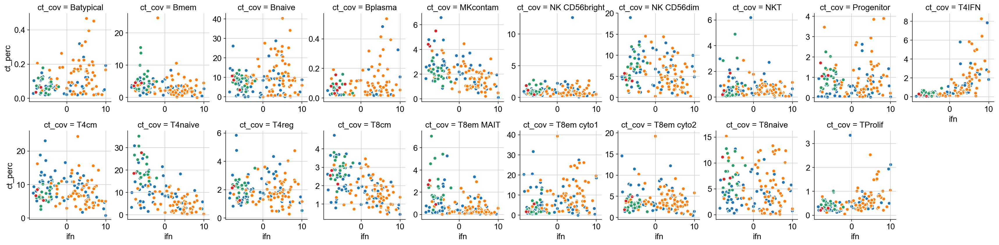

In [135]:
joined2['ct_cov'] = joined2['ct_cov'].astype('category')
g = sb.FacetGrid(joined2, col="ct_cov",  hue="disease_pop_site_cov", aspect=0.8, height=3, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy, col_wrap= 10)
g = g.map(plt.scatter, "ifn", "ct_perc", edgecolor="w")
g.fig.subplots_adjust(wspace=0.2)
g.savefig(figdir+"/ifn.ct_cov.png")

## let's do differential expression analysis between cases and controls for T8em cyto1

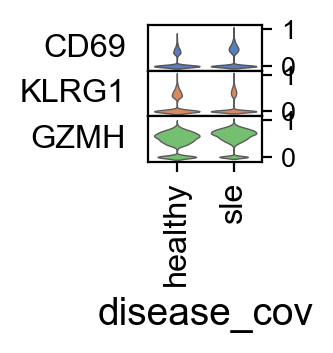

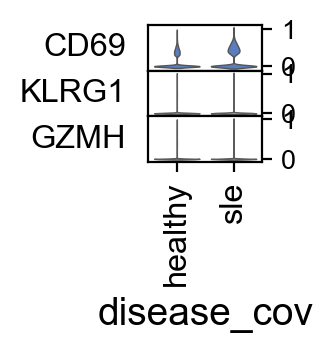

In [73]:
sc.pl.stacked_violin(adata[adata.obs.ct_cov=="T8em cyto1"], var_names=['CD69','KLRG1', 'GZMH'], groupby="disease_cov", swap_axes=True, standard_scale="var")
sc.pl.stacked_violin(adata[adata.obs.ct_cov=="T4naive"], var_names=['CD69','KLRG1', 'GZMH'], groupby="disease_cov", swap_axes=True, standard_scale="var")


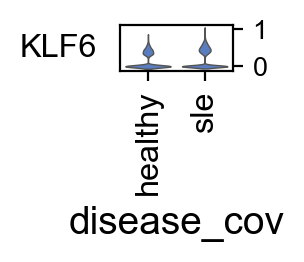

In [74]:
sc.pl.stacked_violin(adata[adata.obs.ct_cov=="T8em cyto1"], var_names=['KLF6'], groupby="disease_cov", swap_axes=True, standard_scale="var")


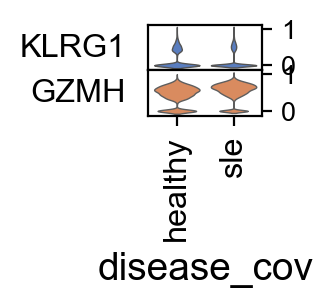

In [75]:
sc.pl.stacked_violin(adata[adata.obs.ct_cov=="T8em cyto1"], var_names=['KLRG1', 'GZMH'], groupby="disease_cov", swap_axes=True, standard_scale="var")


In [76]:
adata_cyto = adata[adata.obs.ct_cov=="T8em cyto1"].copy();

In [77]:
# test = de.test.t_test(
#     data=adata_cyto,
#     grouping="disease_cov",
#     gene_names=adata.var_names
# )

In [78]:
# blah = test.summary(qval_thres=0.05, fc_upper_thres=10, fc_lower_thresh=1).iloc[:30,:]

In [79]:
# blah.sort_values(by="qval")

In [80]:
# test.plot_volcano()

In [81]:
# ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
# ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
# joined2_cd4 = ifn.join(joined_cd4.set_index("ind_cov"), on="name")
# joined_pivot2_cd4 = joined2_cd4.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="estimate")
# joined_pivot2_cd4.reset_index(inplace=True)

# print(joined_pivot2_cd4[joined_pivot2_cd4.pbmc < 0])
# joined_pivot2_cd4 = joined_pivot2_cd4[joined_pivot2_cd4.pbmc > 0]

# print(joined_pivot2_cd4[joined_pivot2_cd4.pbmc > 10])
# joined_pivot2_cd4 = joined_pivot2_cd4[joined_pivot2_cd4.pbmc < 10]


# joined2_cd8 = ifn.join(joined_cd8.set_index("ind_cov"), on="name")
# joined_pivot2_cd8 = joined2_cd8.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="estimate")
# joined_pivot2_cd8.reset_index(inplace=True)

# print(joined_pivot2_cd8[joined_pivot2_cd8.pbmc < 0])
# joined_pivot2_cd8 = joined_pivot2_cd8[joined_pivot2_cd8.pbmc > 0]

# print(joined_pivot2_cd8[joined_pivot2_cd8.pbmc > 10])
# joined_pivot2_cd8 = joined_pivot2_cd8[joined_pivot2_cd8.pbmc < 10]

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cd4s')
# for ct_i in list(range(0,len(ct_percs_cd4.leiden.cat.categories))):
#     ct = ct_percs_cd4.leiden.cat.categories[ct_i]
#     ct_perc_cd4 = joined_pivot2_cd4[ct]
#     ifn = joined_pivot2_cd4.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc_cd4.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))

# print('as a proportion of cd8s')
# for ct_i in list(range(0,len(ct_percs_cd8.leiden.cat.categories))):
#     ct = ct_percs_cd8.leiden.cat.categories[ct_i]
#     ct_perc_cd8 = joined_pivot2_cd8[ct]
#     ifn = joined_pivot2_cd8.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc_cd8.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))

    
# # fig,ax = plt.subplots(nrows=1,ncols=len(adata.obs.leiden.cat.categories), figsize=(20,4))
# # fig.tight_layout()

# # for ct_i in list(range(0,len(adata.obs.leiden.cat.categories))):
# #     ct = ct_percs.leiden.cat.categories[ct_i]
# #     sb.scatterplot(x="ifn", y=ct, data=joined_pivot2, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
# #     ax[ct_i].get_yaxis().label.set_visible(False)
# #     ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])
    

In [82]:
# joined_pivot2_cd4_percs = joined2_cd4.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="ct_percs")
# joined_pivot2_cd4_percs.reset_index(inplace=True)

# print(joined_pivot2_cd4_percs[joined_pivot2_cd4_percs.pbmc < 0])
# joined_pivot2_cd4_percs = joined_pivot2_cd4_percs[joined_pivot2_cd4_percs.pbmc > 0]

# print(joined_pivot2_cd4_percs[joined_pivot2_cd4_percs.pbmc > 10])
# joined_pivot2_cd4_percs = joined_pivot2_cd4_percs[joined_pivot2_cd4_percs.pbmc < 10]

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(ct_percs_cd4.leiden.cat.categories))):
#     ct = ct_percs_cd4.leiden.cat.categories[ct_i]
#     ct_perc = joined_pivot2_cd4_percs[ct]
#     ifn = joined_pivot2_cd4_percs.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))



# joined_pivot2_cd8_percs = joined2_cd8.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="leiden", values="ct_percs")
# joined_pivot2_cd8_percs.reset_index(inplace=True)

# print(joined_pivot2_cd8_percs[joined_pivot2_cd8_percs.pbmc < 0])
# joined_pivot2_cd8_percs = joined_pivot2_cd8_percs[joined_pivot2_cd8_percs.pbmc > 0]

# print(joined_pivot2_cd8_percs[joined_pivot2_cd8_percs.pbmc > 10])
# joined_pivot2_cd8_percs = joined_pivot2_cd8_percs[joined_pivot2_cd8_percs.pbmc < 10]

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(ct_percs_cd8.leiden.cat.categories))):
#     ct = ct_percs_cd8.leiden.cat.categories[ct_i]
#     ct_perc = joined_pivot2_cd8_percs[ct]
#     ifn = joined_pivot2_cd8_percs.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))


In [83]:
# joined2_cd4.leiden = pd.Categorical(joined2_cd4.leiden,
#                                 categories=["0","1","3","12","6","9","7","10","8"],
#                                 ordered=True)

# joined2_cd8.leiden = pd.Categorical(joined2_cd8.leiden,
#                                 categories=["4","2","5","15","13"],
#                                 ordered=True)


In [84]:
# g = sb.FacetGrid(joined2_cd4, col="leiden",  hue="leiden", aspect=0.8, height=3, sharex=False, sharey=False, palette=adata_cd4.uns['leiden_colors'])
# g = g.map(plt.scatter, "ifn", "ct_percs", edgecolor="w")
# g.fig.subplots_adjust(wspace=0.2)
# g.savefig(figdir+"/ifn.cd4.png")

In [85]:
# g = sb.FacetGrid(joined2_cd8, col="leiden",  hue="leiden", aspect=0.8, height=3, sharex=False, sharey=False, palette=adata_cd8.uns['leiden_colors'])
# g = g.map(plt.scatter, "ifn", "ct_percs", edgecolor="w")
# g.fig.subplots_adjust(wspace=0.2)
# g.savefig(figdir+"/ifn.cd8.png")

## let's only look at disease

In [86]:
# joined_pivot2_sle = joined_pivot2[joined_pivot2.disease_cov == "sle"]

# fig,ax = plt.subplots(nrows=1,ncols=len(np.unique(ct_percs.leiden)), figsize=(20,5))
# fig.tight_layout()

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(np.unique(ct_percs.leiden)))):
#     ct = ct_percs.leiden.cat.categories[ct_i]
#     ct_perc = joined_pivot2_sle[ct]
#     ifn = joined_pivot2_sle.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))
    
# for ct_i in list(range(0,len(np.unique(ct_percs.leiden)))):
#     ct = ct_percs.leiden.cat.categories[ct_i]
#     sb.scatterplot(x="ifn", y=ct, data=joined_pivot2_sle, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
#     ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])

## let's only look at healthy

In [87]:
# joined_pivot2_healthy = joined_pivot2[joined_pivot2.disease_cov == "healthy"]

# fig,ax = plt.subplots(nrows=1,ncols=len(np.unique(ct_percs.leiden)), figsize=(20,5))
# fig.tight_layout()

# ##n_cts=ct_df.shape[1]-1
# print('as a proportion of cell type')
# for ct_i in list(range(0,len(np.unique(ct_percs.leiden)))):
#     ct = ct_percs.leiden.cat.categories[ct_i]
#     ct_perc = joined_pivot2_healthy[ct]
#     ifn = joined_pivot2_healthy.ifn
#     ifn = sm.add_constant(ifn)
#     print('Cluster type:'+ ct)
#     est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
#     est=est.fit()
#     effect=est.params[1]
#     pval=est.pvalues[1]
#     print('Beta='+str(effect)+', pvalue='+str(pval))
    
# for ct_i in list(range(0,len(np.unique(ct_percs.leiden)))):
#     ct = ct_percs.leiden.cat.categories[ct_i]
#     sb.scatterplot(x="ifn", y=ct, data=joined_pivot2_healthy, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
#     ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])

# 6. Let's recompute the IFN score

In [88]:
diffexp_annot = pd.read_table("../figure2.prop.var/diffexp.annotations.txt", sep="\t", index_col=False)
diffexp_annot.cluster = diffexp_annot.cluster.astype("category")

/Users/yimmieg/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:1: FutureWarning: read_table is deprecated, use read_csv instead.
  """Entry point for launching an IPython kernel.


In [89]:
for cluster_i in diffexp_annot.cluster.cat.categories:
    print(cluster_i)
    cluster_X = adata.X[:,adata.var_names.isin(diffexp_annot.gene[diffexp_annot.cluster==cluster_i])];
    adata.obs[cluster_i] = np.sum(cluster_X, axis=1)
    

Misc
Mono
Pan
T4
T8_1
T8_2
ncM
pDC


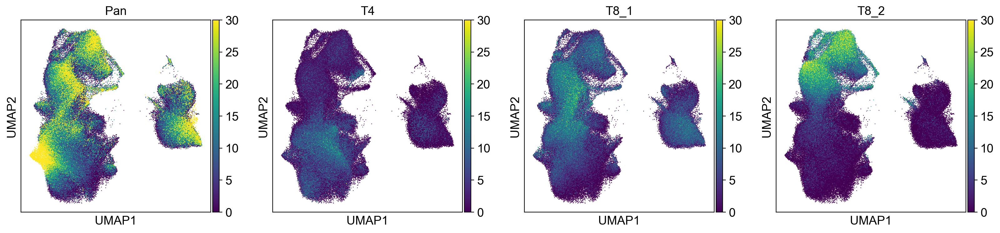

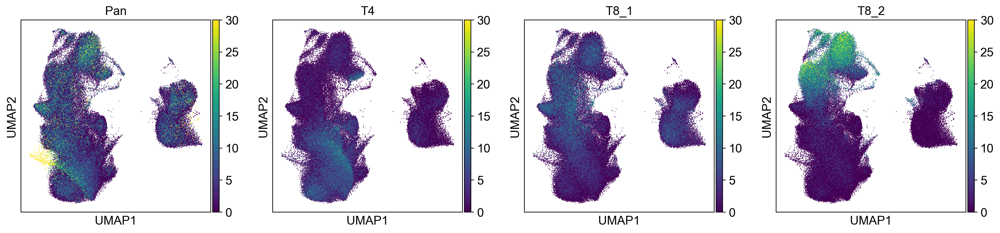

In [90]:
##fig,ax = plt.subplots(nrows=1,ncols=2, figsize=(10,5),sharex=True, sharey=True)
##fig.tight_layout()

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['Pan',"T4","T8_1", "T8_2"], palette="Greys", size=3,vmin=0, vmax=30)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['Pan',"T4","T8_1", "T8_2"], palette="Greys", size=3, vmin=0, vmax=30)



##sc.pl.umap(adata[adata.obs.disease_cov=="healthy",], color = "all_ifn", ax=ax[1])                                                      

saving figure to file ./figures.V6/umap.markers.all.png
saving figure to file ./figures.V6/umap.markers.sle.png
saving figure to file ./figures.V6/umap.markers.healthy.png


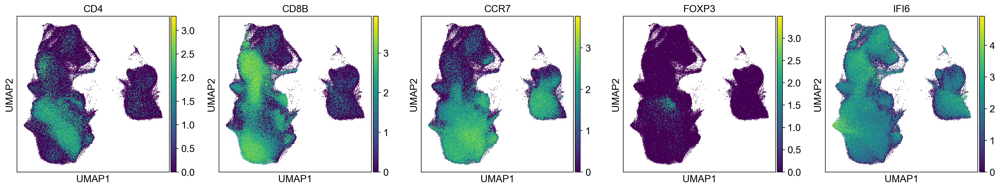

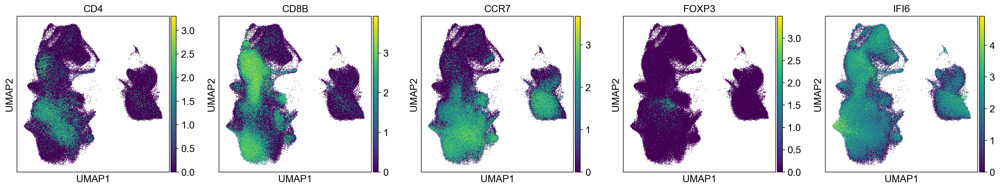

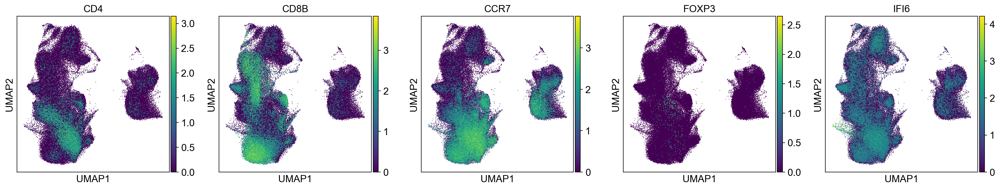

In [91]:
sc.pl.umap(adata, color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3, ncols=5) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3,ncols=5) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)

sc.pl.umap(adata, color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3, ncols=5,save=".markers.all.png") ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3, ncols=5, save=".markers.sle.png") ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD4', 'CD8B','CCR7', "FOXP3","IFI6"], palette="Greys", size=3,ncols=5, save=".markers.healthy.png") ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



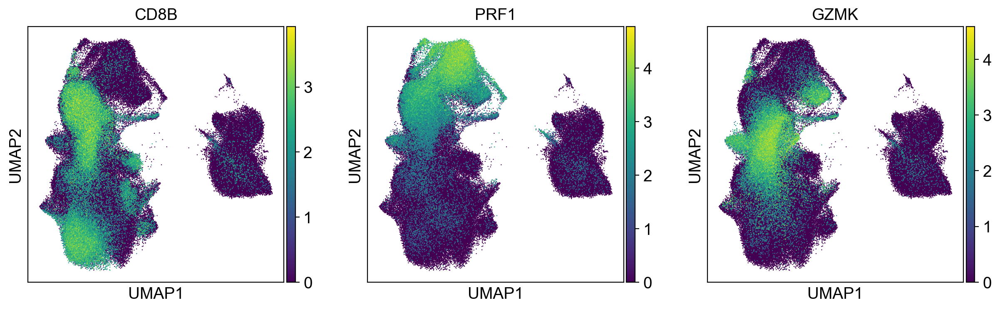

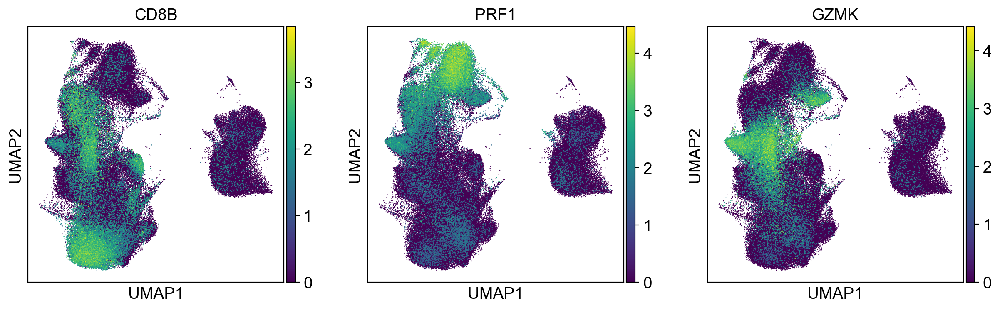

In [92]:
sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD8B',"PRF1","GZMK"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD8B',"PRF1","GZMK"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



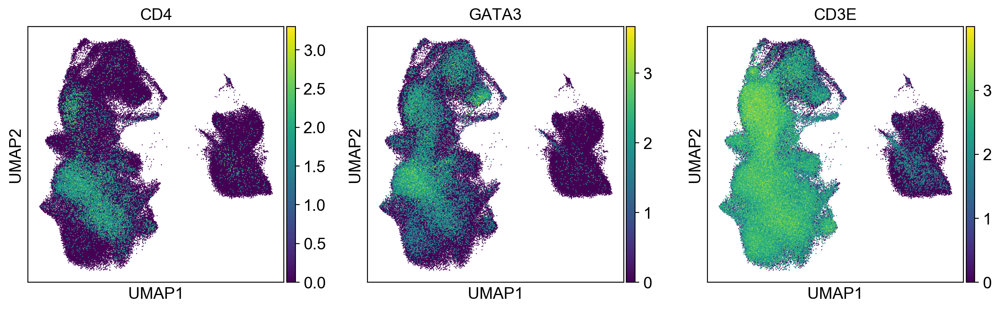

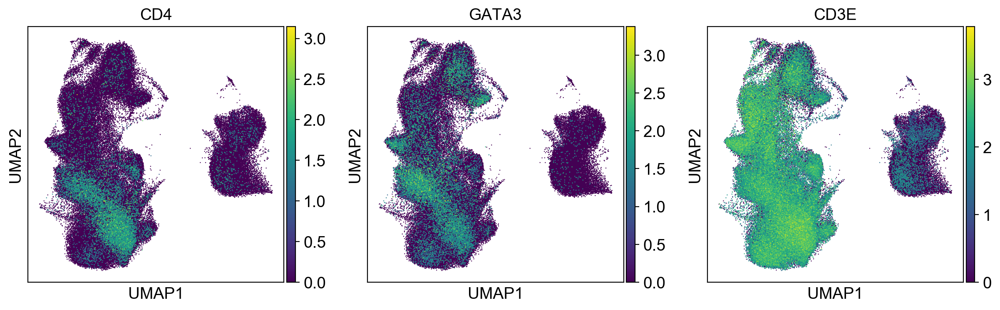

In [93]:


sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD4',"GATA3","CD3E"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD4',"GATA3","CD3E"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)




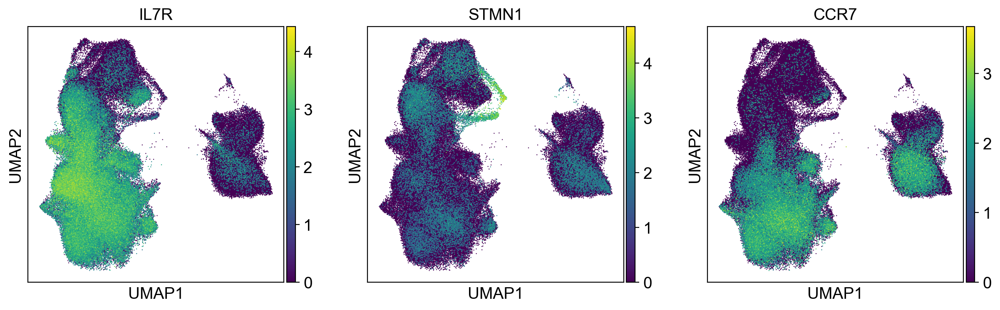

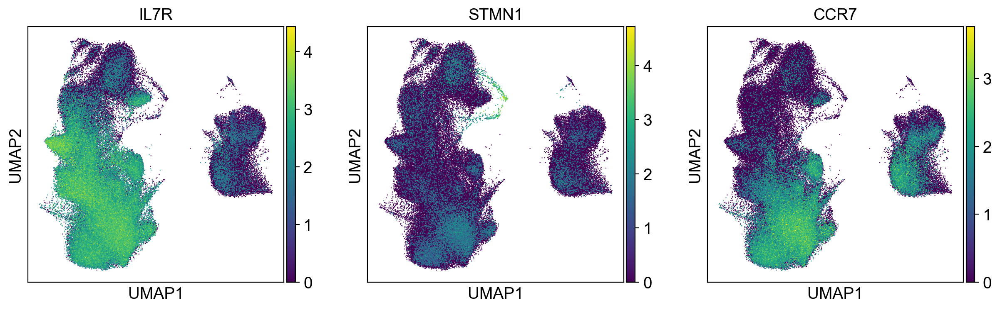

In [94]:

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['IL7R',"STMN1","CCR7"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['IL7R',"STMN1","CCR7"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)


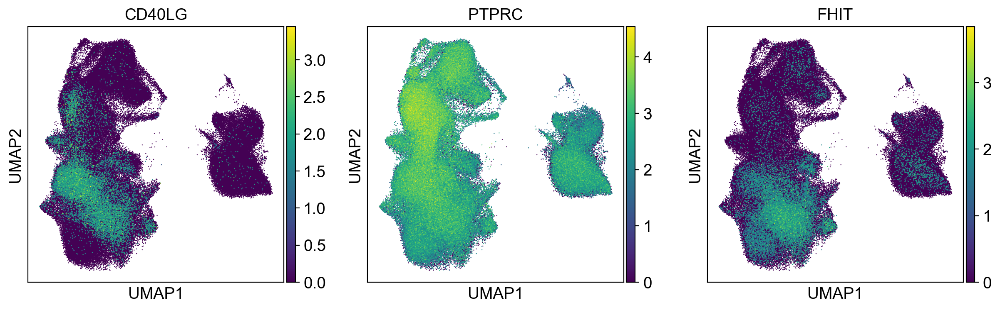

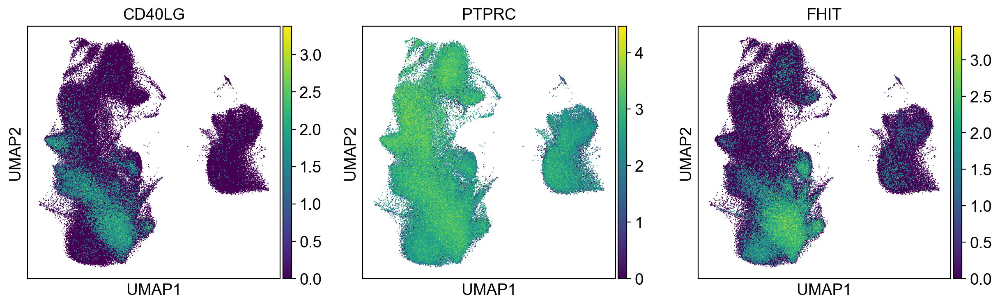

In [95]:

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CD40LG',"PTPRC","FHIT"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CD40LG',"PTPRC","FHIT"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



In [82]:

# sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['CDKN1B',"S100A4","CD69"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
# sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['CDKN1B',"S100A4","CD69"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



In [ ]:

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['RORA',"FOXP3","CREM"], palette="Greys", size=3) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['RORA',"FOXP3","CREM"], palette="Greys", size=3) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



# Memory vs. Naive vs. Th

In [ ]:
#plot UMAP of cell types colored by clusters
adata.uns['louvain_colors'] = sc.pl.palettes.vega_20_scanpy;
sc.pl.umap(adata, color='leiden')

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['SOCS3',"CCR7","CREM", "GATA3", "RORA", "CXCR3", "FOXP1"], palette="Greys", size=2) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['SOCS3',"CCR7","CREM", "GATA3", "RORA", "CXCR3", "FOXP1"], palette="Greys", size=2) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)




In [ ]:

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['STAT1',"STAT6","FOXP1"], palette="Greys", size=1) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['STAT1',"STAT6","FOXP1"], palette="Greys", size=1) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)



In [ ]:

sc.pl.umap(adata[adata.obs.disease_cov=="sle"], color=['PPBP',"CD79A","CD14"], palette="Greys", size=1) ##, vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)
sc.pl.umap(adata[adata.obs.disease_cov=="healthy"], color=['PPBP',"CD79A","CD14"], palette="Greys", size=1) ##,vmin=min(adata.obs.all_ifn), vmax=max(adata.obs.all_ifn)*.75)


In [ ]:
plot_df = adata.obs.groupby(['ind_cov','disease_cov','leiden'])['all_ifn'].mean()
plot_df = plot_df.reset_index(name='all_ifn_sum')

sb.catplot(x="disease_cov", y="all_ifn_sum", hue='leiden', data=plot_df, kind='violin', col='leiden', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.leiden.cat.categories[cluster_i]
    all_ifn_sum = plot_df.all_ifn_sum[plot_df.leiden == cluster]
    disease = plot_df.disease_cov[plot_df.leiden==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(all_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("all_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

In [ ]:
plot_df = adata.obs.groupby(['ind_cov','disease_cov','leiden'])['cm_ifn'].mean()
plot_df = plot_df.reset_index(name='cm_ifn_sum')

sb.catplot(x="disease_cov", y="cm_ifn_sum", hue='leiden', data=plot_df, kind='violin', col='leiden', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.leiden.cat.categories[cluster_i]
    cm_ifn_sum = plot_df.cm_ifn_sum[plot_df.leiden == cluster]
    disease = plot_df.disease_cov[plot_df.leiden==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(cm_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("cm_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

In [ ]:
plot_df = adata.obs.groupby(['ind_cov','disease_cov','louvain'])['myeloid_ifn'].mean()
plot_df = plot_df.reset_index(name='myeloid_ifn_sum')

sb.catplot(x="disease_cov", y="myeloid_ifn_sum", hue='louvain', data=plot_df, kind='violin', col='louvain', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.louvain.cat.categories[cluster_i]
    myeloid_ifn_sum = plot_df.myeloid_ifn_sum[plot_df.louvain == cluster]
    disease = plot_df.disease_cov[plot_df.louvain==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(myeloid_ifn_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("myeloid_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

In [ ]:
plot_df = adata.obs.groupby(['ind_cov','disease_cov','louvain'])['th_specific'].mean()
plot_df = plot_df.reset_index(name='th_specific_sum')

sb.catplot(x="disease_cov", y="th_specific_sum", hue='louvain', data=plot_df, kind='violin', col='louvain', dodge=False, aspect=0.4, sharex=False, sharey=True)

##n_cts=ct_df.shape[1]-1
for cluster_i in list(range(0,8)):
    cluster = plot_df.louvain.cat.categories[cluster_i]
    th_specific_sum = plot_df.th_specific_sum[plot_df.louvain == cluster]
    disease = plot_df.disease_cov[plot_df.louvain==cluster].astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    est=sm.OLS(th_specific_sum.astype(float), disease.astype(float), missing='drop')
    ##est=sm.OLS("myeloid_ifn~disease_cov", data=adata.obs.input,missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Cluster='+str(cluster)+',Beta='+str(effect)+', pvalue='+str(pval))

In [ ]:
# #plot UMAP of cell types colored by clusters
# adata.uns['louvain_colors'] = sc.pl.palettes.vega_20_scanpy;
# sc.pl.umap(adata, color='leiden')

# Remove contaminated clusters and divide analysis into CD4 and CD8

In [ ]:
# CD4
CD4 = adata[adata.obs.ct_cov.isin(['Th', 'Memory CD4+', 'Naive CD4+', 'T Reg', 'Cycling CD4+', 'Cytotoxic CD4+', 'Th1', 'Immature T'])]
print(np.unique(adata.obs.ct_cov))
print(np.unique(CD4.obs.ct_cov))
# CD8
CD8 = adata[adata.obs.ct_cov.isin(['Memory CD8+', 'Naive CD8+', 'Cycling CD8+', 'Cytotoxic CD8+'])]


# Compare UCSF healthy vs SLE CD4

In [ ]:
# Remove Broad samples
CD4 = CD4[CD4.obs.Broad==0]
CD8 = CD8[CD8.obs.Broad==0]

In [ ]:
print(np.unique(CD4.obs.ct_cov))

#get counts of cells for each cluster
ct_counts=CD4.obs.groupby(['ind_cov', 'disease_cov','ct_cov'])['ct_cov'].count()
ct_percs = ct_counts/ct_counts.groupby(level=[0]).transform(sum)*100
ct_percs = ct_percs.reset_index(name='ct_percs')
ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
ct_percs.reset_index(inplace=True)
ct_percs.ct_cov = ct_percs.ct_cov.astype("category")
ct_df=ct_percs.unstack(level=2, fill_value=0)

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(np.unique(CD4.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    ct_perc = ct_percs.ct_percs[ct_percs.ct_cov==ct]
    disease = ct_percs.disease_cov[ct_percs.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))

# #box plot as a proportion of cell type
# vars=[str(x) for x in list(range(n_cts))]
# ct_df['ind_cov']=ct_df.index.get_level_values('ind_cov').tolist()
# ct_df.index=ct_df['ind_cov']
# melted=pd.melt(ct_df, id_vars=['ind_cov', 'disease'], value_vars=vars)

#plot=sb.boxplot(x='disease', y='value', hue=ct_arg, data=melted).get_figure()
plt.figure(figsize=(30,10))
plot=sb.catplot(x='disease_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=.75, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy)
#plt.subplots_adjust(wspace=0.03)


# IFN correlation - Cell Types

In [ ]:
## Let's grab the clinical and labs data and compare to our single cell estimates
clues_clinical = pd.read_table("v2.clinical.data.txt", index_col=False)
clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
joined = ct_percs.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

t1_labs = pd.read_table("T1labs.csv",sep=",")
t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
joined = joined.join(t1_labs.set_index('SubjectID'), on='subjectid')

### test new code
joined.AbsBaso = joined.AbsBaso/1000
joined.AbsEosino = joined.AbsEosino/1000
joined.AbsLympho = joined.AbsLympho/1000
joined.AbsNeutro = joined.AbsNeutro/1000
joined.AbsMono = joined.AbsMono/1000

joined = joined.assign(pbmc = joined.WhiteBloodCell-joined.AbsNeutro-joined.AbsEosino-joined.AbsBaso)

joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

## now let's add in white blood cell counts for the immvar patients
immvar_pbmc = pd.read_table("immvar.pbmc.csv", index_col=False, sep=",")
immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined.pbmc))

## this is not the most efficient code but will suffice for now
for i in list(range(12)) :
    igtb = immvar_pbmc.immvarid[i]
    joined.pbmc[joined.ind_cov==igtb] = immvar_pbmc.pbmc[i]

joined = joined.assign(estimate=joined.ct_percs/100*joined.pbmc)

joined[["ind_cov","disease_cov","ct_cov"]] = joined[["ind_cov","disease_cov","ct_cov"]].astype(str)
joined.plaquenilnow = joined.plaquenilnow.fillna(0)
joined.cellceptnow = joined.cellceptnow.fillna(0)
joined.steroralnow = joined.steroralnow.fillna(0)
joined.acrlymphopenia = joined.acrlymphopenia.fillna(0)

joined_pivot = joined.pivot_table(index=['ind_cov',"disease_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
joined_pivot.reset_index(inplace=True)
joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
joined_pivot.disease_cov = pd.Categorical(joined_pivot.disease_cov,categories=['healthy','sle'], ordered=True)

ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(joined.set_index("ind_cov"), on="name")
joined_pivot2 = joined2.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
joined_pivot2.reset_index(inplace=True)

fig,ax = plt.subplots(nrows=1,ncols=8, figsize=(20,5))
fig.tight_layout()

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(np.unique(CD4.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2[ct]
    ifn = joined_pivot2.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
for ct_i in list(range(0,len(np.unique(CD4.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    sb.scatterplot(x="ifn", y=ct, data=joined_pivot2, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
    ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])
    
joined_pivot2_sle = joined_pivot2[joined_pivot2.disease_cov == "sle"]

fig,ax = plt.subplots(nrows=1,ncols=8, figsize=(20,5))
fig.tight_layout()

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(np.unique(CD4.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_sle[ct]
    ifn = joined_pivot2_sle.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
for ct_i in list(range(0,len(np.unique(CD4.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    sb.scatterplot(x="ifn", y=ct, data=joined_pivot2_sle, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
    ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])
    
joined_pivot2_healthy = joined_pivot2[joined_pivot2.disease_cov == "healthy"]

fig,ax = plt.subplots(nrows=1,ncols=8, figsize=(20,5))
fig.tight_layout()

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(np.unique(CD4.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_healthy[ct]
    ifn = joined_pivot2_healthy.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
for ct_i in list(range(0,len(np.unique(CD4.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    sb.scatterplot(x="ifn", y=ct, data=joined_pivot2_healthy, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
    ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])


# Compare UCSF healthy vs SLE CD8

In [ ]:

#get counts of cells for each cluster
ct_counts=CD8.obs.groupby(['ind_cov', 'disease_cov','ct_cov'])['ct_cov'].count()
ct_percs = ct_counts/ct_counts.groupby(level=[0]).transform(sum)*100
ct_percs = ct_percs.reset_index(name='ct_percs')
ct_percs.ind_cov = ct_percs.ind_cov.apply(lambda x: x.split('_')[0])
ct_percs.ind_cov = ct_percs.ind_cov.astype("str")
ct_percs.reset_index(inplace=True)
ct_percs.ct_cov = ct_percs.ct_cov.astype("category")
ct_df=ct_percs.unstack(level=2, fill_value=0)

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(np.unique(CD8.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    ct_perc = ct_percs.ct_percs[ct_percs.ct_cov==ct]
    disease = ct_percs.disease_cov[ct_percs.ct_cov==ct]
    disease = disease.astype("str")
    disease.values[disease=="sle"] = 0
    disease.values[disease=="healthy"] = 1
    disease = sm.add_constant(disease)
    ##data = data.assign(ct_perc=ct_perc)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), disease.astype(float))
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))

# #box plot as a proportion of cell type
# vars=[str(x) for x in list(range(n_cts))]
# ct_df['ind_cov']=ct_df.index.get_level_values('ind_cov').tolist()
# ct_df.index=ct_df['ind_cov']
# melted=pd.melt(ct_df, id_vars=['ind_cov', 'disease'], value_vars=vars)

#plot=sb.boxplot(x='disease', y='value', hue=ct_arg, data=melted).get_figure()
plt.figure(figsize=(30,10))
plot=sb.catplot(x='disease_cov', y='ct_percs', hue='ct_cov', data=ct_percs, kind='violin', col='ct_cov', dodge=False, aspect=.75, sharex=False, sharey=False, palette=sc.pl.palettes.vega_20_scanpy)
#plt.subplots_adjust(wspace=0.03)

# IFN correlation Cell Type CD8+

In [ ]:
## Let's grab the clinical and labs data and compare to our single cell estimates
clues_clinical = pd.read_table("v2.clinical.data.txt", index_col=False)
clues_clinical.genotypeid = clues_clinical.genotypeid.apply(lambda x: x.split('_')[0])
clues_clinical.subjectid = clues_clinical.subjectid.astype("str")
joined = ct_percs.join(clues_clinical.set_index('genotypeid'), on='ind_cov')

t1_labs = pd.read_table("T1labs.csv",sep=",")
t1_labs.SubjectID = t1_labs.SubjectID.astype("str")
joined = joined.join(t1_labs.set_index('SubjectID'), on='subjectid')

### test new code
joined.AbsBaso = joined.AbsBaso/1000
joined.AbsEosino = joined.AbsEosino/1000
joined.AbsLympho = joined.AbsLympho/1000
joined.AbsNeutro = joined.AbsNeutro/1000
joined.AbsMono = joined.AbsMono/1000

joined = joined.assign(pbmc = joined.WhiteBloodCell-joined.AbsNeutro-joined.AbsEosino-joined.AbsBaso)

joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']] = joined[["subjectid",'WhiteBloodCell','AbsMono','AbsLympho','AbsNeutro','AbsEosino','AbsBaso','PlatCount']].astype(str)

## now let's add in white blood cell counts for the immvar patients
immvar_pbmc = pd.read_table("immvar.pbmc.csv", index_col=False, sep=",")
immvar_pbmc.pbmc = immvar_pbmc.pbmc - (np.mean(immvar_pbmc.pbmc) - np.mean(joined.pbmc))

## this is not the most efficient code but will suffice for now
for i in list(range(12)) :
    igtb = immvar_pbmc.immvarid[i]
    joined.pbmc[joined.ind_cov==igtb] = immvar_pbmc.pbmc[i]

joined = joined.assign(estimate=joined.ct_percs/100*joined.pbmc)

joined[["ind_cov","disease_cov","ct_cov"]] = joined[["ind_cov","disease_cov","ct_cov"]].astype(str)
joined.plaquenilnow = joined.plaquenilnow.fillna(0)
joined.cellceptnow = joined.cellceptnow.fillna(0)
joined.steroralnow = joined.steroralnow.fillna(0)
joined.acrlymphopenia = joined.acrlymphopenia.fillna(0)

joined_pivot = joined.pivot_table(index=['ind_cov',"disease_cov","pbmc","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
joined_pivot.reset_index(inplace=True)
joined_pivot = joined_pivot[joined_pivot.pbmc > 0]
joined_pivot.disease_cov = pd.Categorical(joined_pivot.disease_cov,categories=['healthy','sle'], ordered=True)

ifn = pd.read_table("v2.ifn.sig.txt", sep=" ", index_col=False)
ifn.name = ifn.name.apply(lambda x: x.split('_')[0])
joined2 = ifn.join(joined.set_index("ind_cov"), on="name")
joined_pivot2 = joined2.pivot_table(index=['name',"disease_cov","pbmc","ifn","plaquenilnow","cellceptnow","steroralnow","acrlymphopenia"], columns="ct_cov", values="estimate")
joined_pivot2.reset_index(inplace=True)

fig,ax = plt.subplots(nrows=1,ncols=8, figsize=(20,5))
fig.tight_layout()

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(np.unique(CD8.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2[ct]
    ifn = joined_pivot2.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
for ct_i in list(range(0,len(np.unique(CD8.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    sb.scatterplot(x="ifn", y=ct, data=joined_pivot2, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
    ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])
    
joined_pivot2_sle = joined_pivot2[joined_pivot2.disease_cov == "sle"]

fig,ax = plt.subplots(nrows=1,ncols=8, figsize=(20,5))
fig.tight_layout()

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(np.unique(CD8.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_sle[ct]
    ifn = joined_pivot2_sle.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
for ct_i in list(range(0,len(np.unique(CD8.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    sb.scatterplot(x="ifn", y=ct, data=joined_pivot2_sle, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
    ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])
    
joined_pivot2_healthy = joined_pivot2[joined_pivot2.disease_cov == "healthy"]

fig,ax = plt.subplots(nrows=1,ncols=8, figsize=(20,5))
fig.tight_layout()

##n_cts=ct_df.shape[1]-1
print('as a proportion of cell type')
for ct_i in list(range(0,len(np.unique(CD8.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    ct_perc = joined_pivot2_healthy[ct]
    ifn = joined_pivot2_healthy.ifn
    ifn = sm.add_constant(ifn)
    print('Cluster type:'+ ct)
    est=sm.OLS(ct_perc.astype(float), ifn.astype(float),missing='drop')
    est=est.fit()
    effect=est.params[1]
    pval=est.pvalues[1]
    print('Beta='+str(effect)+', pvalue='+str(pval))
    
for ct_i in list(range(0,len(np.unique(CD8.obs.ct_cov)))):
    ct = ct_percs.ct_cov.cat.categories[ct_i]
    sb.scatterplot(x="ifn", y=ct, data=joined_pivot2_healthy, color=sc.pl.palettes.vega_20_scanpy[ct_i], ax=ax[ct_i])
    ##sb.swarmplot(x="disease_cov", y=ct, data=joined_pivot, color="0", size=3, ax=ax[ct_i])


# Compare CD4 analysis with Broad Healthy controls instead

# Compare CD4 analysis for Broad vs UCSF controls